In this code, we fine tune SAM model to detect water bodies.

SAM paper: https://arxiv.org/abs/2304.02643 (Segment anything model)


# Loading Datasets

In [ ]:
# Mount Google Drive if needed
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !rm -r Water\ Bodies\ Dataset
# !unzip "/content/drive/MyDrive/Water Bodies Dataset.zip"

In [ ]:
!pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 521.2/521.2 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 8.3 MB/s eta 0:00:00


In [ ]:
import os
import numpy as np
from PIL import Image
from datasets import Dataset
from torchvision import transforms

# Function to read and resize jpg images
def read_and_resize_jpg_images(folder_path, file_prefix, target_size=(256, 256)):
    file_list = sorted([f for f in os.listdir(folder_path) if f.startswith(file_prefix) and f.endswith(".jpg")])
    if not file_list:
        raise ValueError(f"No images found in {folder_path} with the prefix {file_prefix}")

    images = [Image.open(os.path.join(folder_path, f)).resize(target_size) for f in file_list]
    return np.stack([np.array(img) for img in images])

def read_and_resize_jpg_images_mask(folder_path, file_prefix, target_size=(256, 256)):
    file_list = sorted([f for f in os.listdir(folder_path) if f.startswith(file_prefix) and f.endswith(".jpg")])
    if not file_list:
        raise ValueError(f"No images found in {folder_path} with the prefix {file_prefix}")

    images = [Image.open(os.path.join(folder_path, f)).convert('L').resize(target_size) for f in file_list]
    return np.stack([np.array(img) for img in images])

# Paths to image and mask folders
images_folder = "/content/drive/MyDrive/Water Bodies Dataset/Images"
masks_folder = "/content/drive/MyDrive/Water Bodies Dataset/Masks"

# Read and resize jpg images and masks
try:
    target_size = (256, 256)
    large_images = read_and_resize_jpg_images(images_folder, "water_body_", target_size=target_size)
    large_masks = read_and_resize_jpg_images_mask(masks_folder, "water_body_", target_size=target_size)
except ValueError as e:
    print(f"Error: {e}")
    large_images, large_masks = None, None

# Create the dataset using the datasets.Dataset class
if large_images is not None and large_masks is not None:
    dataset_dict_train = {
        "image": [Image.fromarray(img.astype(np.uint8)) for img in (large_images[:int(len(large_images)*0.9)])],
        "label": [Image.fromarray(mask.astype(np.uint8)) for mask in (large_masks[:int(len(large_masks)*0.9)])]
    }

    dataset_train = Dataset.from_dict(dataset_dict_train)

    dataset_dict_test = {
        "image": [Image.fromarray(img.astype(np.uint8)) for img in (large_images[int(len(large_images)*0.9):])],
        "label": [Image.fromarray(mask.astype(np.uint8)) for mask in (large_masks[int(len(large_masks)*0.9):])],
    }

    dataset_test = Dataset.from_dict(dataset_dict_test)


In [ ]:
dataset_train, dataset_test

(Dataset({
     features: ['image', 'label'],
     num_rows: 2556
 }),
 Dataset({
     features: ['image', 'label'],
     num_rows: 285
 }))

#Loading images and masks

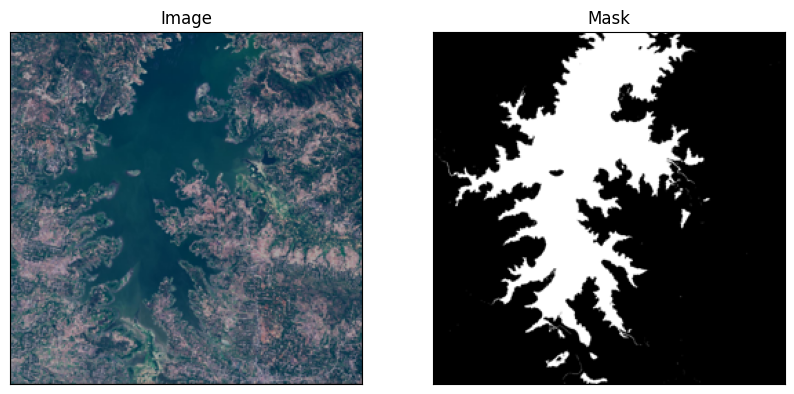

In [ ]:
import matplotlib.pyplot as plt

img_num = 85
example_image = dataset_train[img_num]["image"]
example_mask = dataset_train[img_num]["label"]

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Plot the first image on the left
axes[0].imshow(np.array(example_image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(example_mask, cmap='gray')  # Assuming the second image is grayscale
axes[1].set_title("Mask")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()

#Loading the SAM model

In [ ]:
# Initialize the processor
from transformers import SamProcessor
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

#Data Augmentation

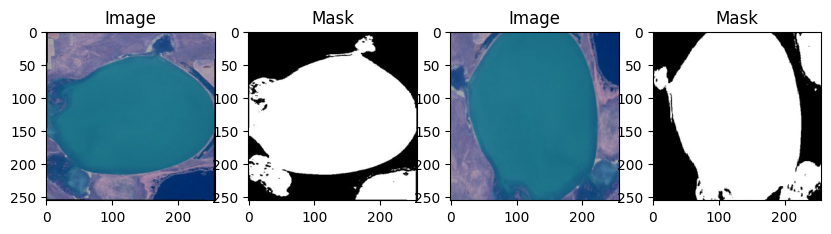

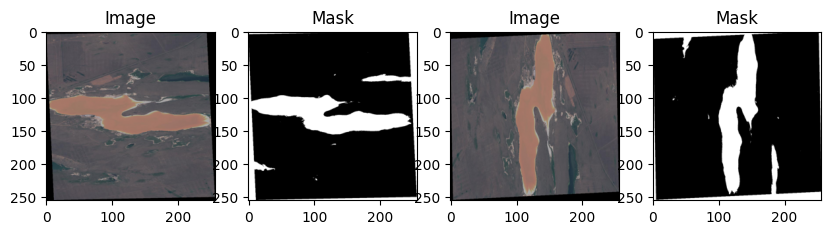

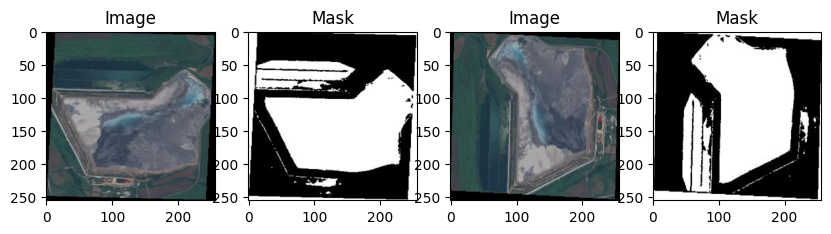

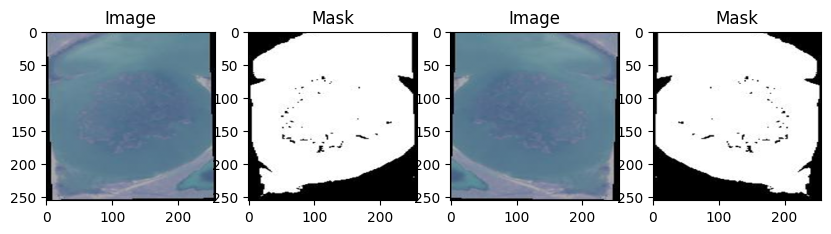

In [ ]:
from torchvision import transforms
import albumentations as A

aug = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.RandomResizedCrop(256, 256, scale=(0.8, 1.0), p=0.5),
    # Add more transformations as needed
])

def show_aug(dataset,aug,idx):
  item = dataset[idx]
  fig, axes = plt.subplots(1, 4, figsize=(10, 5))
  image = np.array(item["image"]) / 255
  ground_truth_mask = np.array(item["label"]) /255
  # Plot the first image on the left
  axes[0].imshow(image)  # Assuming the first image is grayscale
  axes[0].set_title("Image")
  axes[1].imshow(ground_truth_mask, cmap='gray')  # Assuming the second image is grayscale
  axes[1].set_title("Mask")
  if aug:
      augmented = aug(image=image, mask=ground_truth_mask)
      image = augmented['image']
      ground_truth_mask = augmented['mask']

  # Plot the first image on the left
  axes[2].imshow(image)  # Assuming the first image is grayscale
  axes[2].set_title("Image")
  axes[3].imshow(ground_truth_mask, cmap='gray')  # Assuming the second image is grayscale
  axes[3].set_title("Mask")




show_aug(dataset_train,aug,10)
show_aug(dataset_train,aug,25)
show_aug(dataset_train,aug,30)
show_aug(dataset_train,aug,40)


#Setting Bounding Boxes

In [ ]:
#Get bounding boxes from mask.
def get_bounding_box(ground_truth_map):
  # get bounding box from mask
  y_indices, x_indices = np.where(ground_truth_map > 0)
  x_min, x_max = np.min(x_indices), np.max(x_indices)
  y_min, y_max = np.min(y_indices), np.max(y_indices)
  # add perturbation to bounding box coordinates
  H, W = ground_truth_map.shape
  x_min = max(0, x_min - np.random.randint(0, 20))
  x_max = min(W, x_max + np.random.randint(0, 20))
  y_min = max(0, y_min - np.random.randint(0, 20))
  y_max = min(H, y_max + np.random.randint(0, 20))
  bbox = [x_min, y_min, x_max, y_max]

  return bbox

#SAM dataset class

In [ ]:
from torch.utils.data import Dataset
from torchvision import transforms
import torch
import numpy as np

class SAMDataset(Dataset):
    def __init__(self, dataset, processor, augmentations=None):
        self.dataset = dataset
        self.processor = processor
        self.augmentations = augmentations

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        image = np.array(item["image"]) / 255
        ground_truth_mask = np.array(item["label"]) /255

        # apply data augmentations if provided
        if self.augmentations:
            augmented = self.augmentations(image=image, mask=ground_truth_mask)
            image = augmented['image']
            ground_truth_mask = augmented['mask']

        # prepare image and prompt for the model
        prompt = get_bounding_box(ground_truth_mask)
        inputs = self.processor(image, input_boxes=[[prompt]], return_tensors="pt")
        inputs = {k: v.squeeze(0) for k, v in inputs.items()}
        inputs["ground_truth_mask"] = torch.from_numpy(ground_truth_mask)

        return inputs

    def concatenate_datasets(self, other_dataset):

        self.dataset = np.concatenate([self.dataset, other_dataset.dataset], axis=0)


#Augmenting using Albumentations

In [ ]:
# Create an instance of the SAMDataset
from torchvision import transforms
import albumentations as A

aug = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=1),
    A.RandomRotate90(p=0.5),
    A.RandomResizedCrop(256, 256, scale=(0.8, 1.0), p=0.5),
    # Add more transformations as needed
])
train_dataset = SAMDataset(dataset_train, processor,aug)

len(train_dataset)

2556

In [ ]:
example = train_dataset[0]
for k,v in example.items():
  print(k,v.shape)

It looks like you are trying to rescale already rescaled images. If the input images have pixel values between 0 and 1, set `do_rescale=False` to avoid rescaling them again.


pixel_values torch.Size([3, 1024, 1024])
original_sizes torch.Size([2])
reshaped_input_sizes torch.Size([2])
input_boxes torch.Size([1, 4])
ground_truth_mask torch.Size([256, 256])


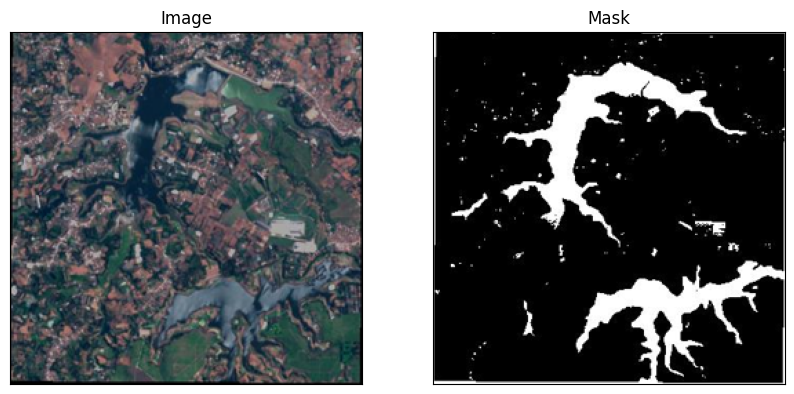

In [ ]:
import matplotlib.pyplot as plt

img_num = 50
example_image = dataset_train[img_num]["image"]
example_mask = dataset_train[img_num]["label"]

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Plot the first image on the left
axes[0].imshow(np.array(example_image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(example_mask, cmap='gray')  # Assuming the second image is grayscale
axes[1].set_title("Mask")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()


#Utils function to show images, masks, bounding boxes, etc

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

def show_boxes_on_image(raw_image, boxes):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image)
    for box in boxes:
      show_box(box, plt.gca())
    plt.axis('on')
    plt.show()

def show_points_on_image(raw_image, input_points, input_labels=None):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image)
    input_points = np.array(input_points)
    if input_labels is None:
      labels = np.ones_like(input_points[:, 0])
    else:
      labels = np.array(input_labels)
    show_points(input_points, labels, plt.gca())
    plt.axis('on')
    plt.show()

def show_points_and_boxes_on_image(raw_image, boxes, input_points, input_labels=None):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image)
    input_points = np.array(input_points)
    if input_labels is None:
      labels = np.ones_like(input_points[:, 0])
    else:
      labels = np.array(input_labels)
    show_points(input_points, labels, plt.gca())
    for box in boxes:
      show_box(box, plt.gca())
    plt.axis('on')
    plt.show()


def show_points_and_boxes_on_image(raw_image, boxes, input_points, input_labels=None):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image)
    input_points = np.array(input_points)
    if input_labels is None:
      labels = np.ones_like(input_points[:, 0])
    else:
      labels = np.array(input_labels)
    show_points(input_points, labels, plt.gca())
    for box in boxes:
      show_box(box, plt.gca())
    plt.axis('on')
    plt.show()



def show_masks_on_image(raw_image, masks, scores):
    if len(masks.shape) == 4:
      masks = masks.squeeze()
    if scores.shape[0] == 1:
      scores = scores.squeeze()

    nb_predictions = scores.shape[-1]
    fig, axes = plt.subplots(1, nb_predictions, figsize=(15, 15))

    for i, (mask, score) in enumerate(zip(masks, scores)):
      mask = mask.cpu().detach()
      axes[i].imshow(np.array(raw_image))
      show_mask(mask, axes[i])
      axes[i].title.set_text(f"Mask {i+1}, Score: {score.item():.3f}")
      axes[i].axis("off")
    plt.show()

#Show bounding box on some sample image

config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/375M [00:00<?, ?B/s]

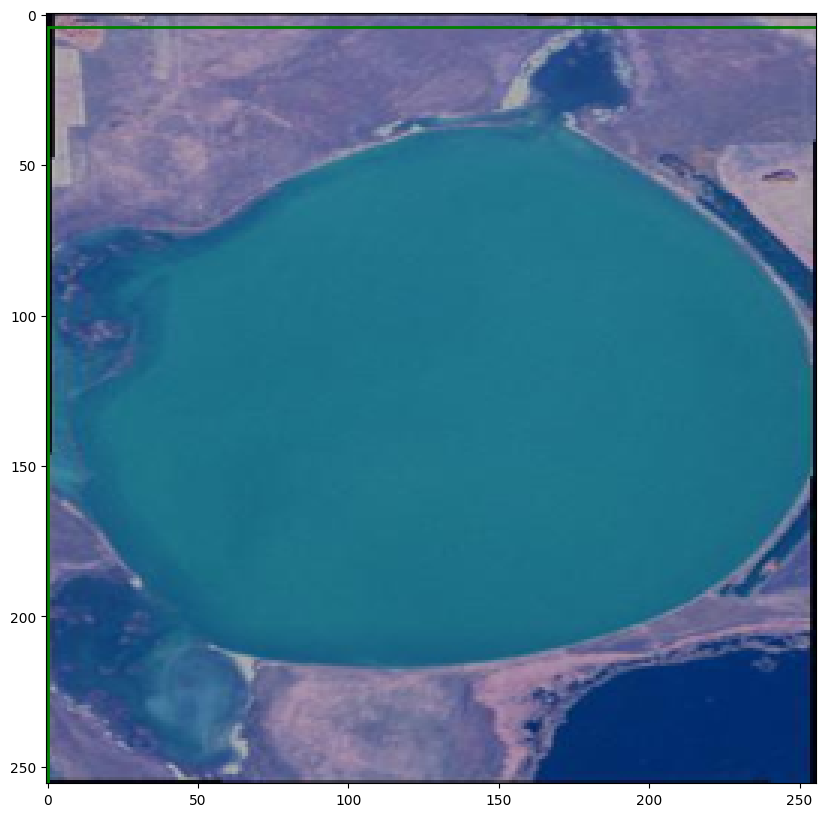

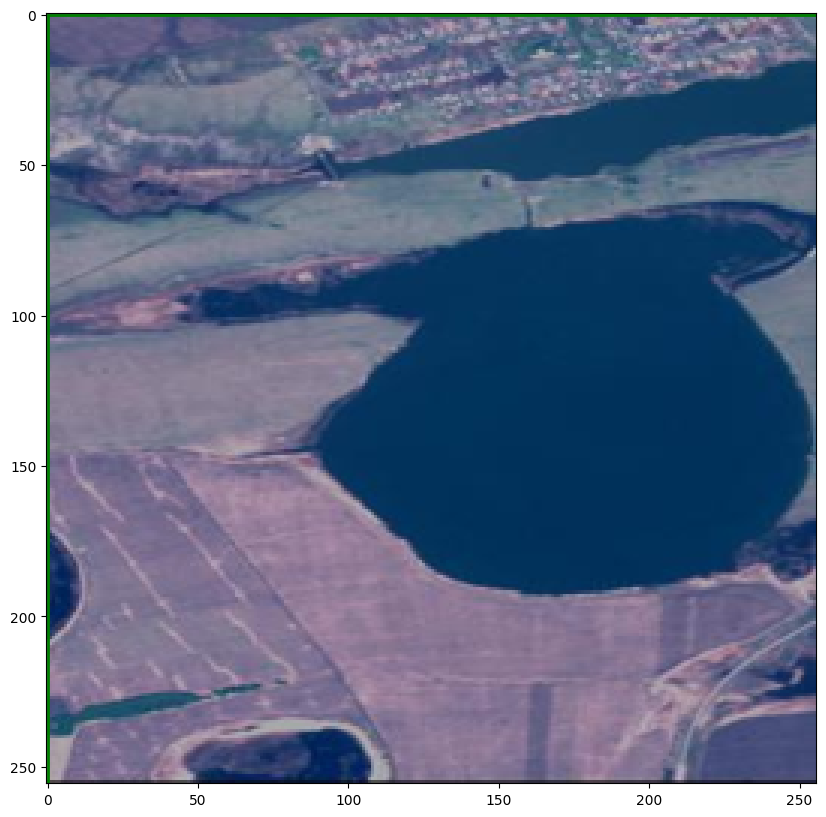

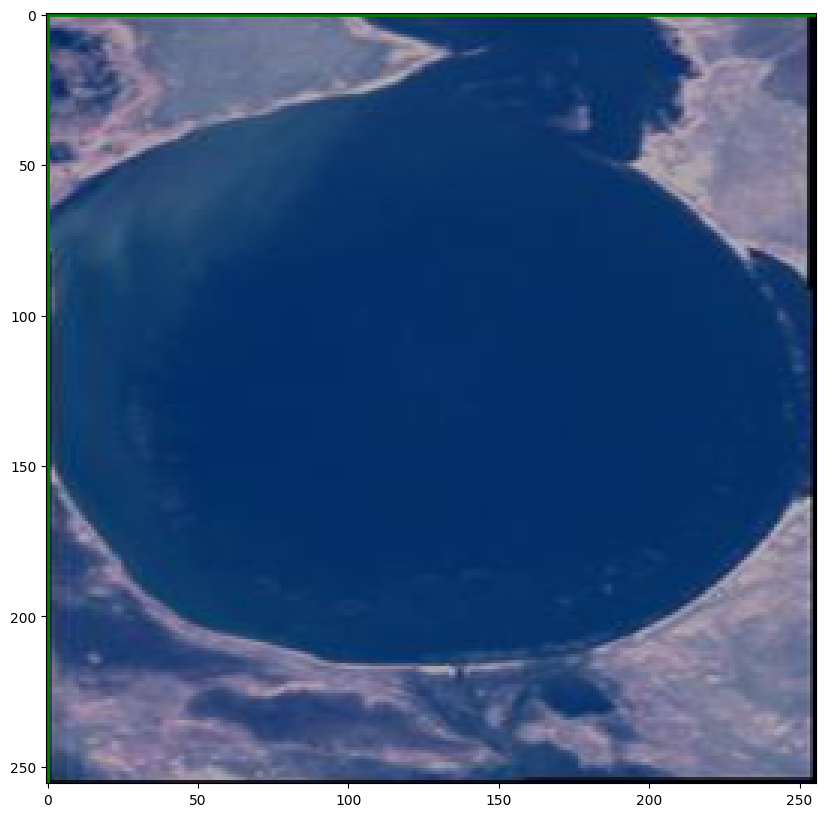

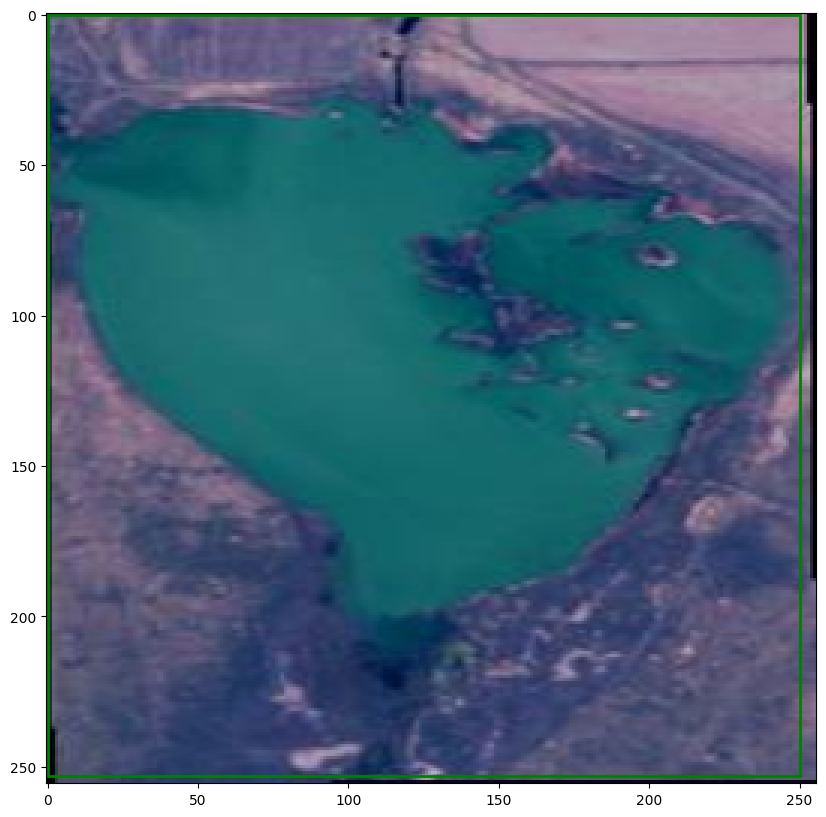

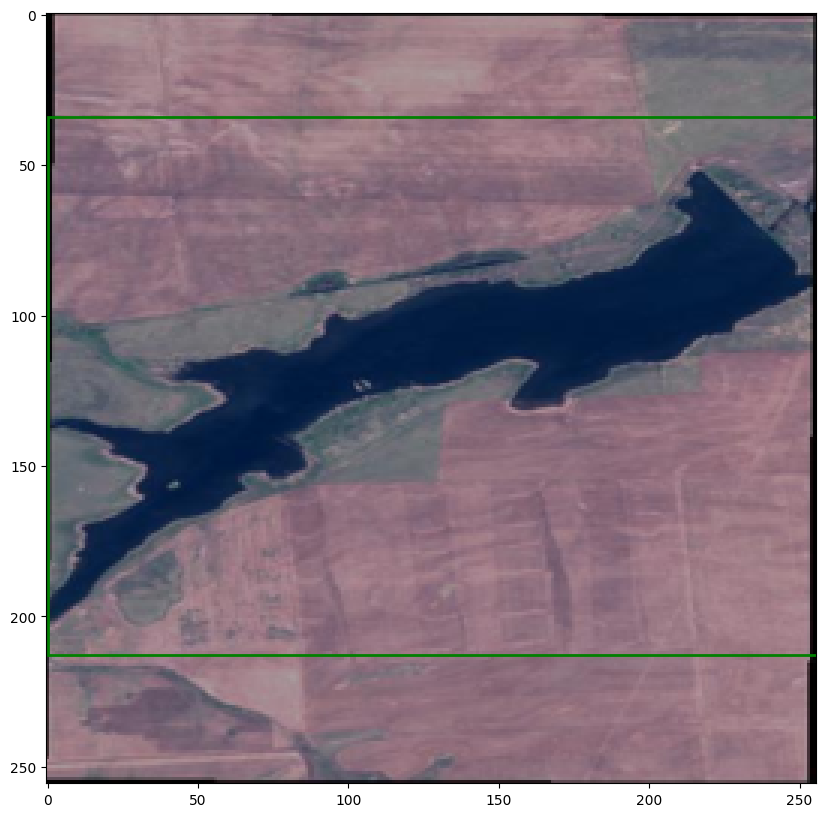

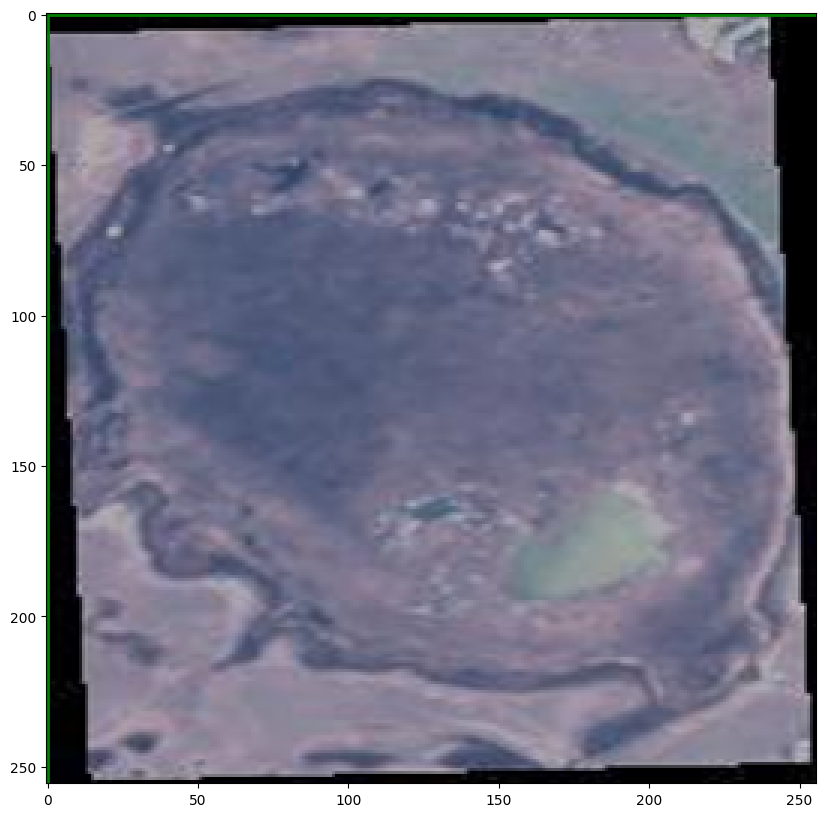

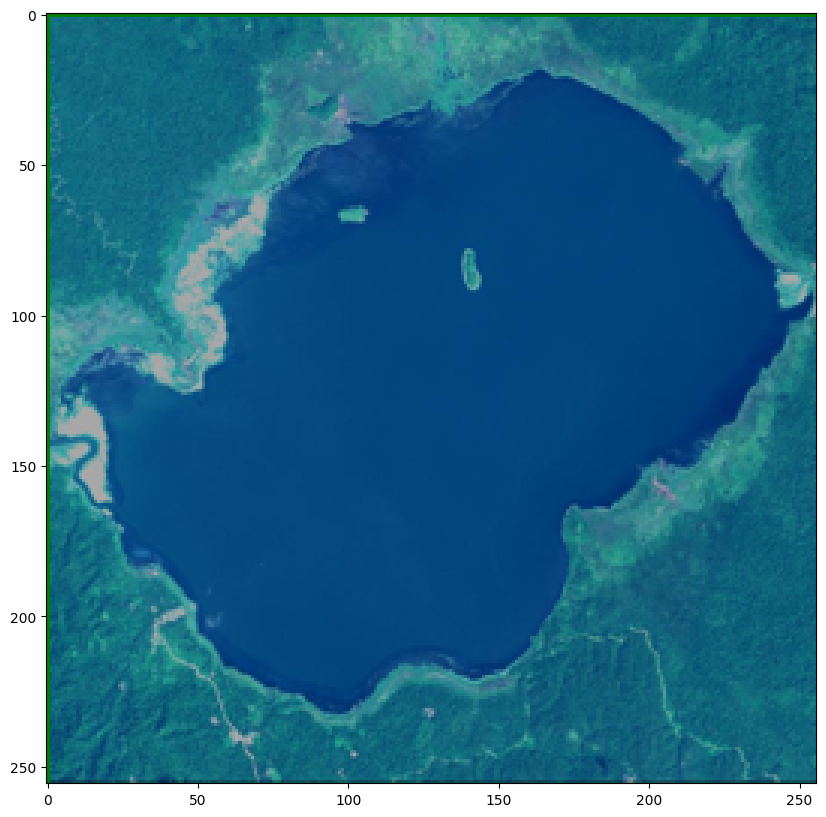

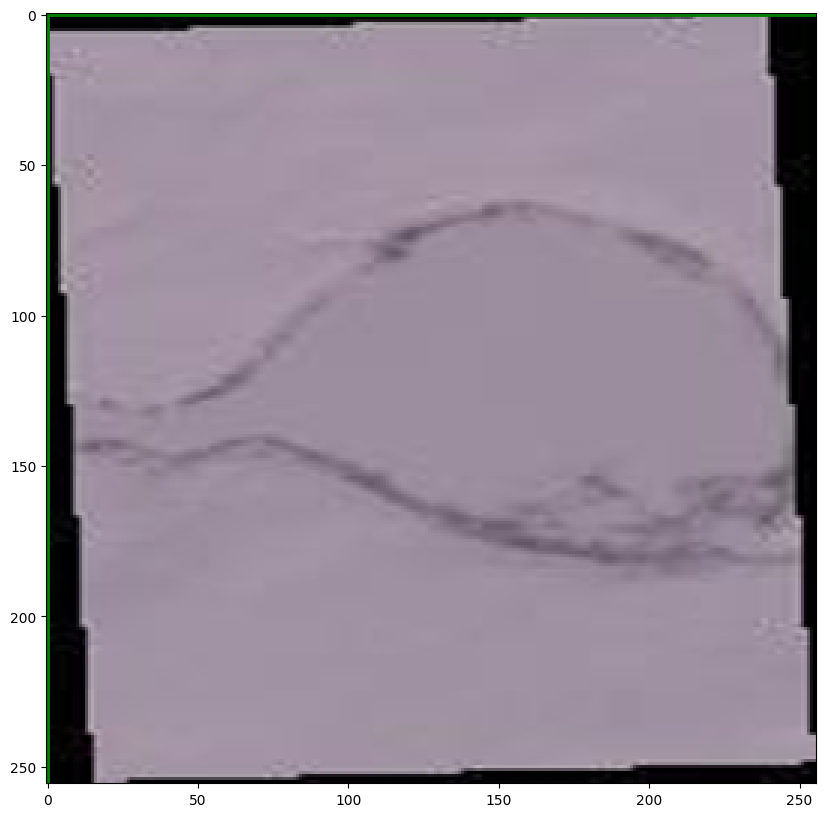

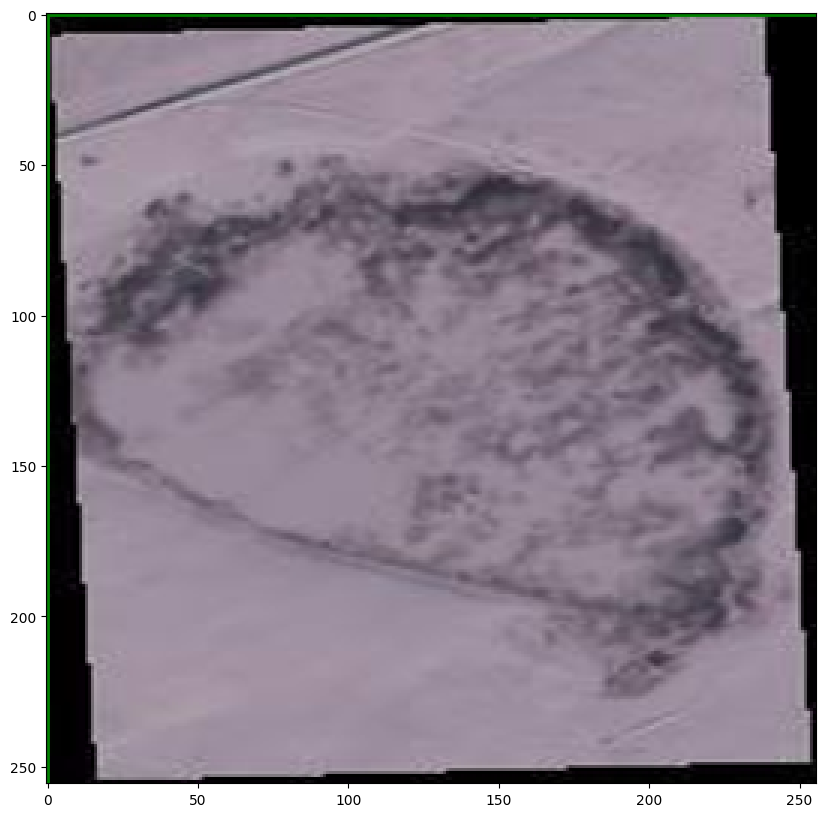

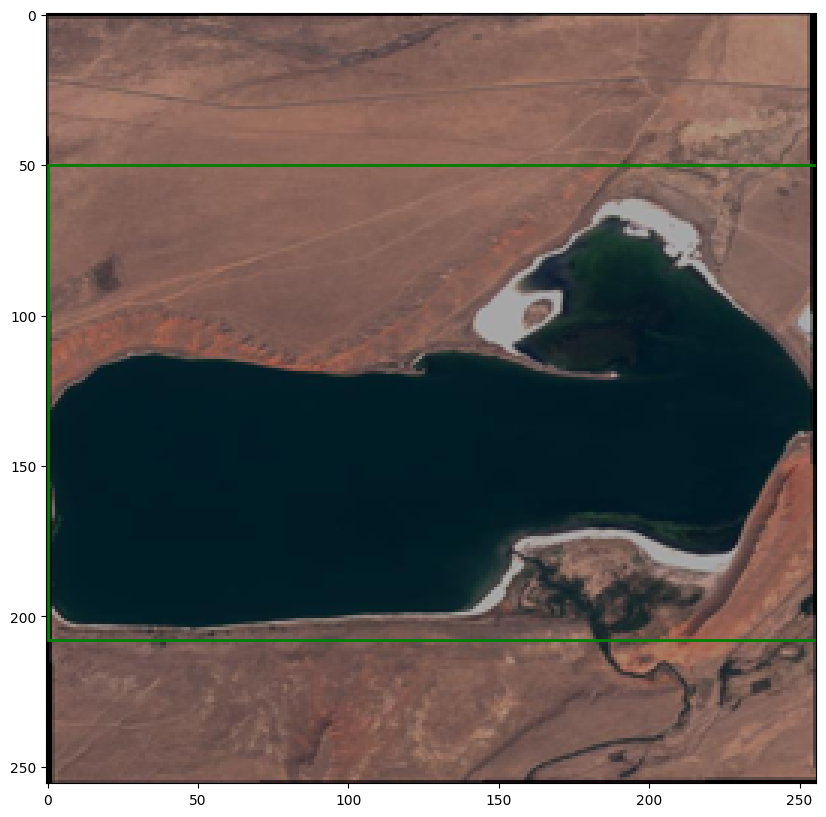

In [ ]:
import numpy as np
from transformers import SamModel

for i in range(10,20):
  ground_truth_mask = np.array(dataset_train[i]["label"])
  # get bounding box prompt

  prompt = get_bounding_box(ground_truth_mask)
  # show_boxes_on_image(dataset_train[i]["image"], [prompt])
  # show_boxes_on_image(dataset_train[i]["label"], [prompt])

  model = SamModel.from_pretrained("facebook/sam-vit-base")

  # inputs = processor(dataset_train[i]["image"], input_boxes=[[prompt]], return_tensors="pt").to('cpu')

  # image_embeddings = model.get_image_embeddings(inputs["pixel_values"])
  # inputs.pop("pixel_values", None)
  # inputs.update({"image_embeddings": image_embeddings})


  # with torch.no_grad():
  #     outputs = model(**inputs)

  # masks = processor.image_processor.post_process_masks(outputs.pred_masks.cpu(), inputs["original_sizes"].cpu(), inputs["reshaped_input_sizes"].cpu())
  # scores = outputs.iou_scores
  show_boxes_on_image(dataset_train[i]["image"], [prompt])

#Training the model

In [ ]:
# Create a DataLoader instance for the training dataset
from torch.utils.data import DataLoader
train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True, drop_last=False)

In [ ]:
batch = next(iter(train_dataloader))
for k,v in batch.items():
  print(k,v.shape)

pixel_values torch.Size([4, 3, 1024, 1024])
original_sizes torch.Size([4, 2])
reshaped_input_sizes torch.Size([4, 2])
input_boxes torch.Size([4, 1, 4])
ground_truth_mask torch.Size([4, 256, 256])


In [ ]:
# Load the model
from transformers import SamModel
model = SamModel.from_pretrained("facebook/sam-vit-base")

# make sure we only compute gradients for mask decoder
for name, param in model.named_parameters():
  if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
    param.requires_grad_(False)

In [ ]:
!pip install monai

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 10.7 MB/s eta 0:00:00


In [ ]:
from torch.optim import Adam
import monai
# Initialize the optimizer and the loss function
optimizer = Adam(model.mask_decoder.parameters(), lr=1e-5, weight_decay=0)
#Try DiceFocalLoss, FocalLoss, DiceCELoss
seg_loss = monai.losses.DiceCELoss(sigmoid=True, squared_pred=True, reduction='mean')

In [ ]:
import torch

def calculate_iou(prediction, target):
    # Convert the tensors to boolean type
    prediction = prediction.bool()
    target = target.bool()

    intersection = (target & prediction).float().sum()
    union = (target | prediction).float().sum()
    iou = intersection / union
    return iou

def calculate_dice_coefficient(prediction, target):
    # Convert the tensors to boolean type
    prediction = prediction.bool()
    target = target.bool()

    intersection = (target & prediction).float().sum()
    dice_coefficient = (2.0 * intersection) / (target.float().sum() + prediction.float().sum())
    return dice_coefficient


In [ ]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn.functional import threshold, normalize

#Training loop
num_epochs = 1

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

model.train()
total_loss = 0.0
total_dice = 0.0
total_iou = 0.0

for epoch in range(num_epochs):
    epoch_losses = []
    dice_losses = []
    iou_losses = []

    for batch in tqdm(train_dataloader):
      # forward pass
      outputs = model(pixel_values=batch["pixel_values"].to(device),
                      input_boxes=batch["input_boxes"].to(device),
                      multimask_output=False)

      # compute loss
      predicted_masks = outputs.pred_masks.squeeze(1)
      ground_truth_masks = batch["ground_truth_mask"].float().to(device)
      loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))
      batch_dice = calculate_iou(predicted_masks, ground_truth_masks.unsqueeze(1))
      batch_iou = calculate_dice_coefficient(predicted_masks, ground_truth_masks.unsqueeze(1))
      print(loss.item(),batch_dice.item(),batch_iou.item())

      # backward pass (compute gradients of parameters w.r.t. loss)
      optimizer.zero_grad()
      loss.backward()

      # optimize
      optimizer.step()
      epoch_losses.append(loss.item())
      dice_losses.append(batch_dice.item())
      iou_losses.append(batch_iou.item())


    print(f'EPOCH: {epoch}')
    print(f'Mean loss: {mean(epoch_losses)}')
    print(f'Mean dice: {mean(dice_losses)}')
    print(f'Mean iou: {mean(iou_losses)}')

  0%|          | 0/639 [00:00<?, ?it/s]

3.333414316177368 0.3617668151855469 0.531319797039032


  0%|          | 2/639 [00:14<1:06:23,  6.25s/it]

2.5586583614349365 0.4031333923339844 0.5746187567710876


  0%|          | 3/639 [00:16<46:49,  4.42s/it]  

1.5576624870300293 0.6258049011230469 0.7698401212692261


  1%|          | 4/639 [00:18<36:33,  3.45s/it]

1.3930171728134155 0.5875129699707031 0.7401677966117859


  1%|          | 5/639 [00:21<33:11,  3.14s/it]

2.0603139400482178 0.3848533630371094 0.5558037757873535


  1%|          | 6/639 [00:23<30:45,  2.92s/it]

1.9460275173187256 0.2731971740722656 0.42915138602256775


  1%|          | 7/639 [00:25<27:21,  2.60s/it]

1.4675860404968262 0.4610557556152344 0.6311268210411072


  1%|▏         | 8/639 [00:27<24:45,  2.35s/it]

1.288238763809204 0.41634368896484375 0.5879133343696594


  1%|▏         | 9/639 [00:29<23:00,  2.19s/it]

1.1231621503829956 0.31296539306640625 0.476730614900589


  2%|▏         | 10/639 [00:31<21:53,  2.09s/it]

1.1566848754882812 0.4342308044433594 0.6055243015289307


  2%|▏         | 11/639 [00:32<21:06,  2.02s/it]

1.0990417003631592 0.4793739318847656 0.6480767726898193


  2%|▏         | 12/639 [00:34<20:34,  1.97s/it]

1.1810837984085083 0.4780998229980469 0.6469114422798157


  2%|▏         | 13/639 [00:36<20:11,  1.93s/it]

1.1640121936798096 0.3153648376464844 0.47950929403305054


  2%|▏         | 14/639 [00:38<20:09,  1.94s/it]

1.1907761096954346 0.21440887451171875 0.3531082272529602


  2%|▏         | 15/639 [00:40<20:15,  1.95s/it]

1.1372449398040771 0.3294677734375 0.4956386089324951


  3%|▎         | 16/639 [00:42<20:19,  1.96s/it]

1.5510250329971313 0.7083740234375 0.8292961716651917


  3%|▎         | 17/639 [00:44<19:57,  1.92s/it]

1.1288412809371948 0.22137832641601562 0.3625057339668274


  3%|▎         | 18/639 [00:46<19:43,  1.91s/it]

1.3235211372375488 0.5560302734375 0.7146779894828796


  3%|▎         | 19/639 [00:48<19:33,  1.89s/it]

1.2103451490402222 0.5201072692871094 0.6843034029006958


  3%|▎         | 20/639 [00:49<19:25,  1.88s/it]

1.2644052505493164 0.29421234130859375 0.45465853810310364


  3%|▎         | 21/639 [00:51<19:24,  1.88s/it]

1.1760382652282715 0.5265426635742188 0.6898499131202698


  3%|▎         | 22/639 [00:53<19:44,  1.92s/it]

1.215279459953308 0.5041694641113281 0.6703625917434692


  4%|▎         | 23/639 [00:55<20:01,  1.95s/it]

1.1187000274658203 0.4459648132324219 0.6168404817581177


  4%|▍         | 24/639 [00:57<20:11,  1.97s/it]

1.1537091732025146 0.6374626159667969 0.7785980701446533


  4%|▍         | 25/639 [00:59<19:56,  1.95s/it]

1.204533576965332 0.3951148986816406 0.5664263367652893


  4%|▍         | 26/639 [01:01<19:47,  1.94s/it]

1.2921172380447388 0.16460418701171875 0.2826783359050751


  4%|▍         | 27/639 [01:03<19:39,  1.93s/it]

1.1758322715759277 0.49042510986328125 0.658100962638855


  4%|▍         | 28/639 [01:05<19:35,  1.92s/it]

1.1892367601394653 0.3086585998535156 0.4717175364494324


  5%|▍         | 29/639 [01:07<19:38,  1.93s/it]

1.1285898685455322 0.5937042236328125 0.745061993598938


  5%|▍         | 30/639 [01:09<19:56,  1.96s/it]

1.100893259048462 0.3588905334472656 0.5282111167907715


  5%|▍         | 31/639 [01:11<20:14,  2.00s/it]

1.0633456707000732 0.4305877685546875 0.6019732356071472


  5%|▌         | 32/639 [01:13<20:23,  2.02s/it]

1.138441801071167 0.6096611022949219 0.7575024366378784


  5%|▌         | 33/639 [01:15<20:05,  1.99s/it]

1.1777894496917725 0.5529518127441406 0.7121300101280212


  5%|▌         | 34/639 [01:17<19:52,  1.97s/it]

1.248741865158081 0.20116424560546875 0.3349487781524658


  5%|▌         | 35/639 [01:19<19:43,  1.96s/it]

1.1453853845596313 0.44705963134765625 0.6178869605064392


  6%|▌         | 36/639 [01:21<19:41,  1.96s/it]

1.148972988128662 0.3630867004394531 0.532741904258728


  6%|▌         | 37/639 [01:23<19:39,  1.96s/it]

1.2484080791473389 0.22035980224609375 0.36113905906677246


  6%|▌         | 38/639 [01:25<19:51,  1.98s/it]

1.0753332376480103 0.4378089904785156 0.6089946627616882


  6%|▌         | 39/639 [01:27<20:08,  2.01s/it]

1.0850841999053955 0.58172607421875 0.7355585694313049


  6%|▋         | 40/639 [01:29<20:20,  2.04s/it]

1.125006079673767 0.4894447326660156 0.6572177410125732


  6%|▋         | 41/639 [01:31<20:10,  2.02s/it]

1.050964593887329 0.5717620849609375 0.7275428175926208


  7%|▋         | 42/639 [01:33<20:03,  2.02s/it]

1.1715668439865112 0.33568572998046875 0.5026417970657349


  7%|▋         | 43/639 [01:35<19:59,  2.01s/it]

1.145675539970398 0.49039459228515625 0.6580734848976135


  7%|▋         | 44/639 [01:37<19:58,  2.01s/it]

1.2060248851776123 0.2824211120605469 0.44044989347457886


  7%|▋         | 45/639 [01:39<19:58,  2.02s/it]

1.129683494567871 0.2817192077636719 0.4395958185195923


  7%|▋         | 46/639 [01:41<20:24,  2.07s/it]

1.1928610801696777 0.3779029846191406 0.5485190153121948


  7%|▋         | 47/639 [01:43<20:33,  2.08s/it]

1.0874991416931152 0.6038246154785156 0.7529808282852173


  8%|▊         | 48/639 [01:46<20:42,  2.10s/it]

1.232762336730957 0.3074531555175781 0.47030848264694214


  8%|▊         | 49/639 [01:48<20:30,  2.09s/it]

1.114553451538086 0.4627647399902344 0.6327261328697205


  8%|▊         | 50/639 [01:50<20:21,  2.07s/it]

1.0977675914764404 0.3889350891113281 0.5600479245185852


  8%|▊         | 51/639 [01:52<20:17,  2.07s/it]

1.1232208013534546 0.4354896545410156 0.6067472100257874


  8%|▊         | 52/639 [01:54<20:12,  2.07s/it]

1.155310869216919 0.6480751037597656 0.7864630818367004


  8%|▊         | 53/639 [01:56<20:05,  2.06s/it]

1.2051239013671875 0.5800743103027344 0.7342367172241211


  8%|▊         | 54/639 [01:58<20:17,  2.08s/it]

1.0967508554458618 0.7024917602539062 0.8252512812614441


  9%|▊         | 55/639 [02:00<20:37,  2.12s/it]

1.0331577062606812 0.44568634033203125 0.6165740489959717


  9%|▉         | 56/639 [02:03<22:36,  2.33s/it]

1.2346673011779785 0.2727165222167969 0.4285581409931183


  9%|▉         | 57/639 [02:05<21:38,  2.23s/it]

1.0672872066497803 0.5970306396484375 0.747675895690918


  9%|▉         | 58/639 [02:07<20:58,  2.17s/it]

1.1921703815460205 0.3707466125488281 0.5409411191940308


  9%|▉         | 59/639 [02:09<20:29,  2.12s/it]

1.1003831624984741 0.5577392578125 0.716088056564331


  9%|▉         | 60/639 [02:11<20:17,  2.10s/it]

1.1271306276321411 0.4339179992675781 0.6052200794219971


 10%|▉         | 61/639 [02:14<21:44,  2.26s/it]

1.3125745058059692 0.22932815551757812 0.3730950951576233


 10%|▉         | 62/639 [02:16<21:19,  2.22s/it]

1.1348737478256226 0.4241905212402344 0.5956935286521912


 10%|▉         | 63/639 [02:18<20:53,  2.18s/it]

1.1247119903564453 0.3333854675292969 0.500058650970459


 10%|█         | 64/639 [02:20<20:17,  2.12s/it]

1.2274813652038574 0.3398780822753906 0.5073269009590149


 10%|█         | 65/639 [02:22<19:50,  2.07s/it]

1.0325754880905151 0.52117919921875 0.6852304935455322


 10%|█         | 66/639 [02:24<19:33,  2.05s/it]

1.3143599033355713 0.21695709228515625 0.3565566837787628


 10%|█         | 67/639 [02:26<19:22,  2.03s/it]

1.2351484298706055 0.3398780822753906 0.5073269009590149


 11%|█         | 68/639 [02:28<19:09,  2.01s/it]

1.2797735929489136 0.22269058227539062 0.3642631769180298


 11%|█         | 69/639 [02:30<19:19,  2.03s/it]

1.0708136558532715 0.7651023864746094 0.8669212460517883


 11%|█         | 70/639 [02:32<19:25,  2.05s/it]

1.2161294221878052 0.3276786804199219 0.4936114251613617


 11%|█         | 71/639 [02:34<19:27,  2.06s/it]

1.123474359512329 0.3310394287109375 0.4974149167537689


 11%|█▏        | 72/639 [02:36<19:10,  2.03s/it]

1.0509347915649414 0.4682273864746094 0.637813150882721


 11%|█▏        | 73/639 [02:38<19:06,  2.03s/it]

1.1325141191482544 0.5442428588867188 0.7048669457435608


 12%|█▏        | 74/639 [02:40<18:56,  2.01s/it]

1.2830286026000977 0.18158340454101562 0.307356059551239


 12%|█▏        | 75/639 [02:42<18:47,  2.00s/it]

1.1226963996887207 0.5231475830078125 0.6869295835494995


 12%|█▏        | 76/639 [02:44<18:41,  1.99s/it]

1.238100528717041 0.22023391723632812 0.36096999049186707


 12%|█▏        | 77/639 [02:46<18:52,  2.02s/it]

1.309704303741455 0.18863296508789062 0.31739479303359985


 12%|█▏        | 78/639 [02:48<19:05,  2.04s/it]

1.1456031799316406 0.37664031982421875 0.5471876859664917


 12%|█▏        | 79/639 [02:50<19:09,  2.05s/it]

1.1330515146255493 0.4655609130859375 0.6353347897529602


 13%|█▎        | 80/639 [02:52<18:52,  2.03s/it]

1.1338412761688232 0.5006370544433594 0.6672326922416687


 13%|█▎        | 81/639 [02:54<18:43,  2.01s/it]

1.145353078842163 0.24491500854492188 0.3934646248817444


 13%|█▎        | 82/639 [02:56<18:35,  2.00s/it]

1.2083786725997925 0.2681770324707031 0.4229331314563751


 13%|█▎        | 83/639 [02:58<18:27,  1.99s/it]

1.0770986080169678 0.23979949951171875 0.3868359327316284


 13%|█▎        | 84/639 [03:00<18:22,  1.99s/it]

1.1086307764053345 0.4473876953125 0.6182002425193787


 13%|█▎        | 85/639 [03:02<18:38,  2.02s/it]

1.1910712718963623 0.3694038391113281 0.5395104289054871


 13%|█▎        | 86/639 [03:04<18:50,  2.04s/it]

1.0910228490829468 0.36814117431640625 0.5381625294685364


 14%|█▎        | 87/639 [03:06<18:58,  2.06s/it]

1.1720569133758545 0.16930007934570312 0.28957507014274597


 14%|█▍        | 88/639 [03:08<18:46,  2.04s/it]

1.2486989498138428 0.5041465759277344 0.6703423261642456


 14%|█▍        | 89/639 [03:10<18:37,  2.03s/it]

1.1906769275665283 0.4670562744140625 0.6367257833480835


 14%|█▍        | 90/639 [03:12<18:29,  2.02s/it]

1.1049473285675049 0.19752120971679688 0.3298834562301636


 14%|█▍        | 91/639 [03:14<18:26,  2.02s/it]

1.1392278671264648 0.3293647766113281 0.49552205204963684


 14%|█▍        | 92/639 [03:16<18:21,  2.01s/it]

1.1541714668273926 0.4470405578613281 0.6178687214851379


 15%|█▍        | 93/639 [03:18<18:36,  2.04s/it]

1.2139407396316528 0.44609832763671875 0.6169681549072266


 15%|█▍        | 94/639 [03:21<18:46,  2.07s/it]

1.041236162185669 0.3117485046386719 0.47531747817993164


 15%|█▍        | 95/639 [03:23<18:50,  2.08s/it]

1.0141973495483398 0.47531890869140625 0.6443608999252319


 15%|█▌        | 96/639 [03:25<18:37,  2.06s/it]

1.1858017444610596 0.3537635803222656 0.5226371884346008


 15%|█▌        | 97/639 [03:27<18:25,  2.04s/it]

1.0375165939331055 0.540863037109375 0.7020261287689209


 15%|█▌        | 98/639 [03:29<18:17,  2.03s/it]

1.0948007106781006 0.19765090942382812 0.3300642967224121


 15%|█▌        | 99/639 [03:31<18:12,  2.02s/it]

1.209164023399353 0.6959266662597656 0.8207037448883057


 16%|█▌        | 100/639 [03:33<18:07,  2.02s/it]

1.1412142515182495 0.4015083312988281 0.5729660391807556


 16%|█▌        | 101/639 [03:35<18:24,  2.05s/it]

1.0712693929672241 0.46968841552734375 0.639167308807373


 16%|█▌        | 102/639 [03:37<18:29,  2.07s/it]

1.2358181476593018 0.4341316223144531 0.6054278612136841


 16%|█▌        | 103/639 [03:39<18:29,  2.07s/it]

1.1955199241638184 0.2559814453125 0.40761977434158325


 16%|█▋        | 104/639 [03:41<18:16,  2.05s/it]

1.2056825160980225 0.3249855041503906 0.4905495345592499


 16%|█▋        | 105/639 [03:43<18:10,  2.04s/it]

1.2147897481918335 0.4653205871582031 0.6351109743118286


 17%|█▋        | 106/639 [03:45<18:02,  2.03s/it]

1.2077816724777222 0.3386993408203125 0.5060125589370728


 17%|█▋        | 107/639 [03:47<17:54,  2.02s/it]

1.1243345737457275 0.4603462219238281 0.6304617524147034


 17%|█▋        | 108/639 [03:49<18:02,  2.04s/it]

1.0978364944458008 0.5227775573730469 0.6866105198860168


 17%|█▋        | 109/639 [03:51<18:14,  2.06s/it]

1.1453962326049805 0.3816642761230469 0.552470326423645


 17%|█▋        | 110/639 [03:53<18:19,  2.08s/it]

1.1727633476257324 0.29083251953125 0.450612336397171


 17%|█▋        | 111/639 [03:55<18:04,  2.05s/it]

1.1315480470657349 0.357177734375 0.526353657245636


 18%|█▊        | 112/639 [03:57<17:52,  2.03s/it]

1.082963228225708 0.4232940673828125 0.5948089957237244


 18%|█▊        | 113/639 [03:59<17:42,  2.02s/it]

1.0997240543365479 0.5925178527832031 0.744127094745636


 18%|█▊        | 114/639 [04:01<17:34,  2.01s/it]

1.0397059917449951 0.598114013671875 0.7485248446464539


 18%|█▊        | 115/639 [04:03<17:31,  2.01s/it]

1.1281297206878662 0.5438308715820312 0.7045212984085083


 18%|█▊        | 116/639 [04:05<17:46,  2.04s/it]

1.0889241695404053 0.6474266052246094 0.7859853506088257


 18%|█▊        | 117/639 [04:08<17:54,  2.06s/it]

1.0653420686721802 0.5429496765136719 0.7037814259529114


 18%|█▊        | 118/639 [04:10<18:02,  2.08s/it]

1.0860967636108398 0.5124015808105469 0.6775999069213867


 19%|█▊        | 119/639 [04:12<17:45,  2.05s/it]

1.1572668552398682 0.35492706298828125 0.5239058136940002


 19%|█▉        | 120/639 [04:14<17:34,  2.03s/it]

1.000340223312378 0.31032562255859375 0.4736618399620056


 19%|█▉        | 121/639 [04:16<17:30,  2.03s/it]

1.1799927949905396 0.3186683654785156 0.4833184480667114


 19%|█▉        | 122/639 [04:18<17:21,  2.01s/it]

1.1620502471923828 0.45470428466796875 0.6251501441001892


 19%|█▉        | 123/639 [04:20<17:17,  2.01s/it]

1.3305262327194214 0.18861007690429688 0.31736239790916443


 19%|█▉        | 124/639 [04:22<17:33,  2.05s/it]

1.0944819450378418 0.6044845581054688 0.7534937858581543


 20%|█▉        | 125/639 [04:24<17:42,  2.07s/it]

1.1695572137832642 0.39160919189453125 0.5628148913383484


 20%|█▉        | 126/639 [04:26<17:48,  2.08s/it]

1.1128671169281006 0.2788429260253906 0.4360862672328949


 20%|█▉        | 127/639 [04:28<17:33,  2.06s/it]

1.0407235622406006 0.5203094482421875 0.6844783425331116


 20%|██        | 128/639 [04:30<17:20,  2.04s/it]

1.255048394203186 0.3474617004394531 0.5157277584075928


 20%|██        | 129/639 [04:32<17:14,  2.03s/it]

1.089217185974121 0.5608634948730469 0.7186579704284668


 20%|██        | 130/639 [04:34<17:08,  2.02s/it]

1.208457350730896 0.4261665344238281 0.5976392030715942


 21%|██        | 131/639 [04:36<17:05,  2.02s/it]

1.0703647136688232 0.4122772216796875 0.5838474631309509


 21%|██        | 132/639 [04:38<17:20,  2.05s/it]

1.0138816833496094 0.33661651611328125 0.5036845207214355


 21%|██        | 133/639 [04:40<17:28,  2.07s/it]

1.1374162435531616 0.5818214416503906 0.7356348037719727


 21%|██        | 134/639 [04:42<17:35,  2.09s/it]

1.0409070253372192 0.6374893188476562 0.7786179780960083


 21%|██        | 135/639 [04:44<17:19,  2.06s/it]

1.0074098110198975 0.6755485534667969 0.8063610792160034


 21%|██▏       | 136/639 [04:46<17:07,  2.04s/it]

0.987912118434906 0.4657478332519531 0.6355088353157043


 21%|██▏       | 137/639 [04:48<16:58,  2.03s/it]

0.9253042936325073 0.43115997314453125 0.6025322079658508


 22%|██▏       | 138/639 [04:50<16:50,  2.02s/it]

0.9678174257278442 0.3556976318359375 0.5247448086738586


 22%|██▏       | 139/639 [04:52<16:45,  2.01s/it]

1.0520117282867432 0.5754928588867188 0.7305559515953064


 22%|██▏       | 140/639 [04:54<16:58,  2.04s/it]

0.9923665523529053 0.4309043884277344 0.6022825837135315


 22%|██▏       | 141/639 [04:57<17:07,  2.06s/it]

1.365499496459961 0.19946670532226562 0.33259230852127075


 22%|██▏       | 142/639 [04:59<17:14,  2.08s/it]

1.0657048225402832 0.4756126403808594 0.6446307301521301


 22%|██▏       | 143/639 [05:01<17:00,  2.06s/it]

0.7328709363937378 0.3347320556640625 0.5015718936920166


 23%|██▎       | 144/639 [05:03<16:48,  2.04s/it]

0.9551076292991638 0.5036048889160156 0.6698633432388306


 23%|██▎       | 145/639 [05:05<16:42,  2.03s/it]

1.0052525997161865 0.4407958984375 0.6118783354759216


 23%|██▎       | 146/639 [05:07<16:37,  2.02s/it]

1.1056928634643555 0.5909538269042969 0.7428925037384033


 23%|██▎       | 147/639 [05:09<16:34,  2.02s/it]

1.261390209197998 0.5056228637695312 0.6716461181640625


 23%|██▎       | 148/639 [05:11<16:47,  2.05s/it]

1.1769535541534424 0.2582206726074219 0.4104537069797516


 23%|██▎       | 149/639 [05:13<16:57,  2.08s/it]

1.2100895643234253 0.3203125 0.48520711064338684


 23%|██▎       | 150/639 [05:15<16:46,  2.06s/it]

1.1659939289093018 0.4492340087890625 0.619960606098175


 24%|██▎       | 151/639 [05:17<16:36,  2.04s/it]

1.2251558303833008 0.2742042541503906 0.43039292097091675


 24%|██▍       | 152/639 [05:19<16:27,  2.03s/it]

0.8723543882369995 0.5416107177734375 0.7026556134223938


 24%|██▍       | 153/639 [05:21<16:20,  2.02s/it]

1.1919102668762207 0.5706138610839844 0.7266125082969666


 24%|██▍       | 154/639 [05:23<16:14,  2.01s/it]

1.033542513847351 0.3602294921875 0.5296598672866821


 24%|██▍       | 155/639 [05:25<16:20,  2.03s/it]

0.8642810583114624 0.3830718994140625 0.5539435744285583


 24%|██▍       | 156/639 [05:27<16:29,  2.05s/it]

0.8614794611930847 0.5956230163574219 0.7465711236000061


 25%|██▍       | 157/639 [05:29<16:36,  2.07s/it]

0.9813440442085266 0.3469429016113281 0.515156090259552


 25%|██▍       | 158/639 [05:31<16:24,  2.05s/it]

0.9965845942497253 0.4942436218261719 0.6615301966667175


 25%|██▍       | 159/639 [05:33<16:16,  2.03s/it]

1.1270971298217773 0.5121307373046875 0.6773630380630493


 25%|██▌       | 160/639 [05:35<16:09,  2.02s/it]

1.166351556777954 0.5197029113769531 0.6839532852172852


 25%|██▌       | 161/639 [05:37<16:03,  2.02s/it]

1.2022831439971924 0.5822715759277344 0.7359944581985474


 25%|██▌       | 162/639 [05:39<15:58,  2.01s/it]

0.9949561953544617 0.35213470458984375 0.5208574533462524


 26%|██▌       | 163/639 [05:41<16:10,  2.04s/it]

1.0554829835891724 0.4557647705078125 0.6261516809463501


 26%|██▌       | 164/639 [05:43<16:19,  2.06s/it]

0.9787572622299194 0.572845458984375 0.7284192442893982


 26%|██▌       | 165/639 [05:46<16:24,  2.08s/it]

1.0406373739242554 0.58416748046875 0.7375072240829468


 26%|██▌       | 166/639 [05:48<16:10,  2.05s/it]

0.933236300945282 0.4737091064453125 0.6428800821304321


 26%|██▌       | 167/639 [05:50<16:01,  2.04s/it]

1.2568295001983643 0.36524200439453125 0.5350582599639893


 26%|██▋       | 168/639 [05:52<15:51,  2.02s/it]

1.038646936416626 0.31766510009765625 0.4821636378765106


 26%|██▋       | 169/639 [05:54<15:46,  2.01s/it]

1.0773229598999023 0.5774345397949219 0.732118546962738


 27%|██▋       | 170/639 [05:56<15:44,  2.01s/it]

1.0112550258636475 0.530303955078125 0.693070113658905


 27%|██▋       | 171/639 [05:58<15:56,  2.04s/it]

0.8236603736877441 0.4494781494140625 0.6201930642127991


 27%|██▋       | 172/639 [06:00<16:00,  2.06s/it]

1.3133208751678467 0.47078704833984375 0.6401838660240173


 27%|██▋       | 173/639 [06:02<16:06,  2.07s/it]

1.022036075592041 0.47270965576171875 0.6419590711593628


 27%|██▋       | 174/639 [06:04<15:53,  2.05s/it]

1.1748814582824707 0.2535400390625 0.4045184552669525


 27%|██▋       | 175/639 [06:06<15:41,  2.03s/it]

1.1617348194122314 0.232818603515625 0.3777013123035431


 28%|██▊       | 176/639 [06:08<15:33,  2.02s/it]

1.236581802368164 0.2873497009277344 0.4464205801486969


 28%|██▊       | 177/639 [06:10<15:29,  2.01s/it]

1.039534330368042 0.5313835144042969 0.6939914226531982


 28%|██▊       | 178/639 [06:12<15:25,  2.01s/it]

0.8975391387939453 0.40354156494140625 0.5750333070755005


 28%|██▊       | 179/639 [06:14<15:35,  2.03s/it]

1.1110315322875977 0.2776679992675781 0.4346481263637543


 28%|██▊       | 180/639 [06:16<15:43,  2.06s/it]

1.2692859172821045 0.21469497680664062 0.35349610447883606


 28%|██▊       | 181/639 [06:18<15:47,  2.07s/it]

1.2587543725967407 0.27276611328125 0.428619384765625


 28%|██▊       | 182/639 [06:20<15:34,  2.05s/it]

1.1450300216674805 0.773956298828125 0.8725765347480774


 29%|██▊       | 183/639 [06:22<15:25,  2.03s/it]

1.1054704189300537 0.7031402587890625 0.8256986141204834


 29%|██▉       | 184/639 [06:24<15:20,  2.02s/it]

1.074636459350586 0.36722564697265625 0.5371837019920349


 29%|██▉       | 185/639 [06:26<15:16,  2.02s/it]

1.000535011291504 0.5719413757324219 0.7276878952980042


 29%|██▉       | 186/639 [06:28<15:13,  2.02s/it]

1.0598628520965576 0.3288917541503906 0.49498653411865234


 29%|██▉       | 187/639 [06:30<15:26,  2.05s/it]

1.0128847360610962 0.3172874450683594 0.4817284941673279


 29%|██▉       | 188/639 [06:32<15:33,  2.07s/it]

1.1204631328582764 0.2950172424316406 0.4556190073490143


 30%|██▉       | 189/639 [06:35<15:37,  2.08s/it]

1.2769925594329834 0.4312629699707031 0.6026327610015869


 30%|██▉       | 190/639 [06:37<15:24,  2.06s/it]

1.0862674713134766 0.5620841979980469 0.7196592688560486


 30%|██▉       | 191/639 [06:39<15:16,  2.05s/it]

1.1091620922088623 0.2540779113769531 0.4052027463912964


 30%|███       | 192/639 [06:41<15:10,  2.04s/it]

1.1625217199325562 0.20764923095703125 0.343889981508255


 30%|███       | 193/639 [06:43<15:05,  2.03s/it]

1.1447386741638184 0.45221710205078125 0.6227954626083374


 30%|███       | 194/639 [06:45<14:59,  2.02s/it]

1.1247109174728394 0.1856536865234375 0.3131667971611023


 31%|███       | 195/639 [06:47<15:10,  2.05s/it]

1.197986125946045 0.4587593078613281 0.6289718747138977


 31%|███       | 196/639 [06:49<15:16,  2.07s/it]

0.9759016036987305 0.4671440124511719 0.6368073225021362


 31%|███       | 197/639 [06:51<15:05,  2.05s/it]

0.9253447651863098 0.5429954528808594 0.7038198709487915


 31%|███       | 198/639 [06:53<14:58,  2.04s/it]

1.293569803237915 0.46121978759765625 0.6312805414199829


 31%|███       | 199/639 [06:55<14:49,  2.02s/it]

0.8057370185852051 0.3839988708496094 0.5549120903015137


 31%|███▏      | 200/639 [06:57<14:44,  2.01s/it]

1.0625145435333252 0.25096893310546875 0.401239275932312


 31%|███▏      | 201/639 [06:59<14:41,  2.01s/it]

1.1864194869995117 0.3841743469238281 0.5550953149795532


 32%|███▏      | 202/639 [07:01<14:54,  2.05s/it]

1.1615656614303589 0.2901802062988281 0.44982895255088806


 32%|███▏      | 203/639 [07:03<15:02,  2.07s/it]

0.995752215385437 0.4250907897949219 0.5965806245803833


 32%|███▏      | 204/639 [07:05<15:10,  2.09s/it]

1.200094223022461 0.24185943603515625 0.38951176404953003


 32%|███▏      | 205/639 [07:07<14:58,  2.07s/it]

0.9716798663139343 0.32592010498046875 0.4916134774684906


 32%|███▏      | 206/639 [07:09<14:48,  2.05s/it]

1.0990591049194336 0.33666229248046875 0.5037357807159424


 32%|███▏      | 207/639 [07:11<14:39,  2.04s/it]

1.268306016921997 0.3839759826660156 0.5548881888389587


 33%|███▎      | 208/639 [07:13<14:33,  2.03s/it]

1.1886136531829834 0.3606910705566406 0.5301586389541626


 33%|███▎      | 209/639 [07:15<14:30,  2.02s/it]

1.057999610900879 0.4489173889160156 0.6196590662002563


 33%|███▎      | 210/639 [07:17<14:43,  2.06s/it]

0.990420401096344 0.33446502685546875 0.5012720823287964


 33%|███▎      | 211/639 [07:20<14:50,  2.08s/it]

0.9285221695899963 0.4330596923828125 0.60438472032547


 33%|███▎      | 212/639 [07:22<14:55,  2.10s/it]

1.1116254329681396 0.6211814880371094 0.7663318514823914


 33%|███▎      | 213/639 [07:24<14:41,  2.07s/it]

1.0651965141296387 0.4850730895996094 0.6532649397850037


 33%|███▎      | 214/639 [07:26<14:35,  2.06s/it]

1.149749755859375 0.26647186279296875 0.4208097755908966


 34%|███▎      | 215/639 [07:28<14:26,  2.04s/it]

1.1092638969421387 0.5162429809570312 0.6809502243995667


 34%|███▍      | 216/639 [07:30<14:20,  2.03s/it]

1.0283002853393555 0.490936279296875 0.6585610508918762


 34%|███▍      | 217/639 [07:32<14:16,  2.03s/it]

1.1112127304077148 0.42201995849609375 0.5935499668121338


 34%|███▍      | 218/639 [07:34<14:26,  2.06s/it]

1.1675201654434204 0.5041656494140625 0.670359194278717


 34%|███▍      | 219/639 [07:36<14:30,  2.07s/it]

1.0512385368347168 0.3116455078125 0.47519776225090027


 34%|███▍      | 220/639 [07:38<14:33,  2.08s/it]

1.0145981311798096 0.29994964599609375 0.4614788591861725


 35%|███▍      | 221/639 [07:40<14:21,  2.06s/it]

0.8624503016471863 0.3663978576660156 0.5362975001335144


 35%|███▍      | 222/639 [07:42<14:11,  2.04s/it]

1.1327921152114868 0.4382438659667969 0.6094152331352234


 35%|███▍      | 223/639 [07:44<14:04,  2.03s/it]

1.1142536401748657 0.3322410583496094 0.49877017736434937


 35%|███▌      | 224/639 [07:46<13:58,  2.02s/it]

1.0371731519699097 0.38768768310546875 0.558753490447998


 35%|███▌      | 225/639 [07:48<13:52,  2.01s/it]

1.026833176612854 0.649810791015625 0.7877397537231445


 35%|███▌      | 226/639 [07:50<14:02,  2.04s/it]

0.9475813508033752 0.30126190185546875 0.4630303978919983


 36%|███▌      | 227/639 [07:52<14:10,  2.06s/it]

0.9271575212478638 0.31479644775390625 0.4788520038127899


 36%|███▌      | 228/639 [07:54<14:10,  2.07s/it]

1.0864672660827637 0.32021331787109375 0.48509329557418823


 36%|███▌      | 229/639 [07:56<13:57,  2.04s/it]

1.0346686840057373 0.3528175354003906 0.5216040015220642


 36%|███▌      | 230/639 [07:58<13:48,  2.03s/it]

1.108939290046692 0.5316009521484375 0.6941768527030945


 36%|███▌      | 231/639 [08:00<13:42,  2.02s/it]

0.9298398494720459 0.41144561767578125 0.5830130577087402


 36%|███▋      | 232/639 [08:02<13:36,  2.01s/it]

0.7781481146812439 0.4917640686035156 0.6593053936958313


 36%|███▋      | 233/639 [08:04<13:34,  2.01s/it]

1.048176884651184 0.41890716552734375 0.5904645323753357


 37%|███▋      | 234/639 [08:06<13:47,  2.04s/it]

1.001873254776001 0.4835205078125 0.6518555283546448


 37%|███▋      | 235/639 [08:09<13:55,  2.07s/it]

1.0293768644332886 0.3973846435546875 0.5687548518180847


 37%|███▋      | 236/639 [08:11<13:44,  2.05s/it]

0.8390954732894897 0.25669097900390625 0.40851885080337524


 37%|███▋      | 237/639 [08:13<13:36,  2.03s/it]

1.104376196861267 0.255859375 0.40746501088142395


 37%|███▋      | 238/639 [08:15<13:32,  2.03s/it]

1.0946991443634033 0.44295501708984375 0.6139553785324097


 37%|███▋      | 239/639 [08:17<13:28,  2.02s/it]

0.7944403290748596 0.3438301086425781 0.5117166042327881


 38%|███▊      | 240/639 [08:19<13:27,  2.02s/it]

0.9268088936805725 0.49103546142578125 0.658650279045105


 38%|███▊      | 241/639 [08:21<13:36,  2.05s/it]

1.177149772644043 0.4468994140625 0.617733895778656


 38%|███▊      | 242/639 [08:23<13:46,  2.08s/it]

1.0693292617797852 0.3010597229003906 0.4627915620803833


 38%|███▊      | 243/639 [08:25<13:46,  2.09s/it]

1.1750516891479492 0.5573692321777344 0.7157829999923706


 38%|███▊      | 244/639 [08:27<13:34,  2.06s/it]

1.2371188402175903 0.4323768615722656 0.6037194132804871


 38%|███▊      | 245/639 [08:29<13:25,  2.04s/it]

0.9673699736595154 0.31209564208984375 0.4757208824157715


 38%|███▊      | 246/639 [08:31<13:19,  2.03s/it]

1.1442110538482666 0.46236419677734375 0.6323516368865967


 39%|███▊      | 247/639 [08:33<13:14,  2.03s/it]

0.8907260298728943 0.5692558288574219 0.7255105376243591


 39%|███▉      | 248/639 [08:35<13:11,  2.02s/it]

1.113753318786621 0.492340087890625 0.6598228812217712


 39%|███▉      | 249/639 [08:37<13:24,  2.06s/it]

1.1164414882659912 0.6381111145019531 0.7790815830230713


 39%|███▉      | 250/639 [08:39<13:29,  2.08s/it]

0.9955179691314697 0.3935890197753906 0.5648566484451294


 39%|███▉      | 251/639 [08:41<13:30,  2.09s/it]

0.9782374501228333 0.35718536376953125 0.5263619422912598


 39%|███▉      | 252/639 [08:43<13:18,  2.06s/it]

1.1770987510681152 0.3216896057128906 0.4867854118347168


 40%|███▉      | 253/639 [08:45<13:10,  2.05s/it]

0.9157524704933167 0.3718833923339844 0.5421501398086548


 40%|███▉      | 254/639 [08:47<13:04,  2.04s/it]

1.081732153892517 0.4357872009277344 0.6070359349250793


 40%|███▉      | 255/639 [08:49<12:59,  2.03s/it]

1.0326340198516846 0.3604469299316406 0.5298948884010315


 40%|████      | 256/639 [08:51<12:54,  2.02s/it]

1.3438575267791748 0.12767791748046875 0.22644394636154175


 40%|████      | 257/639 [08:54<13:01,  2.05s/it]

1.1106162071228027 0.5359115600585938 0.6978417038917542


 40%|████      | 258/639 [08:56<13:08,  2.07s/it]

0.9969257712364197 0.42870330810546875 0.600129246711731


 41%|████      | 259/639 [08:58<13:11,  2.08s/it]

0.9913978576660156 0.5368881225585938 0.6986690759658813


 41%|████      | 260/639 [09:00<13:00,  2.06s/it]

1.0217320919036865 0.5255165100097656 0.6889686584472656


 41%|████      | 261/639 [09:02<12:49,  2.04s/it]

1.218305230140686 0.4809112548828125 0.6494801640510559


 41%|████      | 262/639 [09:04<12:43,  2.03s/it]

1.0770025253295898 0.4170341491699219 0.5886014103889465


 41%|████      | 263/639 [09:06<12:37,  2.02s/it]

1.1346421241760254 0.4198417663574219 0.5913923382759094


 41%|████▏     | 264/639 [09:08<12:34,  2.01s/it]

1.0042064189910889 0.3668937683105469 0.5368285179138184


 41%|████▏     | 265/639 [09:10<12:45,  2.05s/it]

1.1166218519210815 0.4724693298339844 0.6417374014854431


 42%|████▏     | 266/639 [09:12<12:52,  2.07s/it]

0.842552661895752 0.3498878479003906 0.5183954238891602


 42%|████▏     | 267/639 [09:14<12:56,  2.09s/it]

1.0888612270355225 0.3256797790527344 0.4913400411605835


 42%|████▏     | 268/639 [09:16<12:44,  2.06s/it]

1.1239590644836426 0.2870521545410156 0.4460614323616028


 42%|████▏     | 269/639 [09:18<12:35,  2.04s/it]

1.1177194118499756 0.5313453674316406 0.6939588785171509


 42%|████▏     | 270/639 [09:20<12:29,  2.03s/it]

1.1860854625701904 0.4965934753417969 0.6636317372322083


 42%|████▏     | 271/639 [09:22<12:24,  2.02s/it]

0.9683369398117065 0.3599433898925781 0.5293505191802979


 43%|████▎     | 272/639 [09:24<12:20,  2.02s/it]

1.1369657516479492 0.33393096923828125 0.5006720423698425


 43%|████▎     | 273/639 [09:26<12:30,  2.05s/it]

1.2093923091888428 0.3288459777832031 0.49493467807769775


 43%|████▎     | 274/639 [09:28<12:34,  2.07s/it]

1.2599741220474243 0.4149208068847656 0.5864933133125305


 43%|████▎     | 275/639 [09:30<12:33,  2.07s/it]

1.01469886302948 0.3773384094238281 0.5479240417480469


 43%|████▎     | 276/639 [09:32<12:22,  2.05s/it]

1.0912197828292847 0.4218177795410156 0.5933499932289124


 43%|████▎     | 277/639 [09:34<12:15,  2.03s/it]

1.1400370597839355 0.3998985290527344 0.5713250041007996


 44%|████▎     | 278/639 [09:36<12:11,  2.02s/it]

1.2172436714172363 0.31594085693359375 0.48017486929893494


 44%|████▎     | 279/639 [09:39<12:08,  2.02s/it]

0.9584487676620483 0.4460296630859375 0.6169025301933289


 44%|████▍     | 280/639 [09:41<12:13,  2.04s/it]

1.1064807176589966 0.5103073120117188 0.6757661700248718


 44%|████▍     | 281/639 [09:43<12:18,  2.06s/it]

1.2729840278625488 0.2348175048828125 0.3803274631500244


 44%|████▍     | 282/639 [09:45<12:22,  2.08s/it]

1.1411460638046265 0.41768646240234375 0.5892508029937744


 44%|████▍     | 283/639 [09:47<12:12,  2.06s/it]

0.9781795144081116 0.4317474365234375 0.6031056046485901


 44%|████▍     | 284/639 [09:49<12:04,  2.04s/it]

1.0976221561431885 0.33853912353515625 0.5058337450027466


 45%|████▍     | 285/639 [09:51<11:57,  2.03s/it]

1.120823860168457 0.2688636779785156 0.42378655076026917


 45%|████▍     | 286/639 [09:53<11:53,  2.02s/it]

1.0557820796966553 0.7943305969238281 0.8853781819343567


 45%|████▍     | 287/639 [09:55<11:49,  2.02s/it]

0.954701840877533 0.4064369201660156 0.5779668092727661


 45%|████▌     | 288/639 [09:57<12:00,  2.05s/it]

1.1405863761901855 0.4227485656738281 0.5942702293395996


 45%|████▌     | 289/639 [09:59<12:04,  2.07s/it]

0.940079391002655 0.5735664367675781 0.7290018796920776


 45%|████▌     | 290/639 [10:01<12:09,  2.09s/it]

1.3038029670715332 0.18823623657226562 0.3168330192565918


 46%|████▌     | 291/639 [10:03<11:57,  2.06s/it]

1.1333603858947754 0.2633323669433594 0.4168853461742401


 46%|████▌     | 292/639 [10:05<11:48,  2.04s/it]

1.0687384605407715 0.3912773132324219 0.5624720454216003


 46%|████▌     | 293/639 [10:07<11:43,  2.03s/it]

1.045675277709961 0.3043022155761719 0.4666130542755127


 46%|████▌     | 294/639 [10:09<11:37,  2.02s/it]

0.9527120590209961 0.66558837890625 0.7992231249809265


 46%|████▌     | 295/639 [10:11<11:33,  2.01s/it]

1.0196809768676758 0.7072868347167969 0.8285506963729858


 46%|████▋     | 296/639 [10:13<11:41,  2.05s/it]

1.1819446086883545 0.16366958618164062 0.28129908442497253


 46%|████▋     | 297/639 [10:15<11:47,  2.07s/it]

0.8121483325958252 0.5197677612304688 0.6840094327926636


 47%|████▋     | 298/639 [10:18<11:49,  2.08s/it]

0.914971113204956 0.32757568359375 0.49349454045295715


 47%|████▋     | 299/639 [10:20<11:39,  2.06s/it]

1.148038625717163 0.6628952026367188 0.7972784042358398


 47%|████▋     | 300/639 [10:22<11:32,  2.04s/it]

0.9615378379821777 0.4949455261230469 0.6621586084365845


 47%|████▋     | 301/639 [10:24<11:26,  2.03s/it]

0.9877276420593262 0.425323486328125 0.5968097448348999


 47%|████▋     | 302/639 [10:26<11:22,  2.03s/it]

1.2218352556228638 0.22264480590820312 0.36420193314552307


 47%|████▋     | 303/639 [10:28<11:18,  2.02s/it]

0.7633939981460571 0.4711952209472656 0.6405611038208008


 48%|████▊     | 304/639 [10:30<11:26,  2.05s/it]

1.0061136484146118 0.4303131103515625 0.6017047762870789


 48%|████▊     | 305/639 [10:32<11:31,  2.07s/it]

1.0448493957519531 0.53973388671875 0.7010742425918579


 48%|████▊     | 306/639 [10:34<11:34,  2.08s/it]

0.9533731341362 0.3852081298828125 0.5561736226081848


 48%|████▊     | 307/639 [10:36<11:22,  2.06s/it]

1.0914812088012695 0.4294929504394531 0.6009024977684021


 48%|████▊     | 308/639 [10:38<11:16,  2.04s/it]

1.2902549505233765 0.3978385925292969 0.5692196488380432


 48%|████▊     | 309/639 [10:40<11:10,  2.03s/it]

1.152282476425171 0.32001495361328125 0.48486563563346863


 49%|████▊     | 310/639 [10:42<11:09,  2.03s/it]

0.8986846804618835 0.4739799499511719 0.6431294679641724


 49%|████▊     | 311/639 [10:44<11:03,  2.02s/it]

1.0906606912612915 0.5241050720214844 0.6877545118331909


 49%|████▉     | 312/639 [10:46<11:12,  2.06s/it]

1.0147876739501953 0.23813247680664062 0.38466396927833557


 49%|████▉     | 313/639 [10:48<11:18,  2.08s/it]

0.9869351983070374 0.6243400573730469 0.7687307000160217


 49%|████▉     | 314/639 [10:50<11:18,  2.09s/it]

0.9777321815490723 0.7568893432617188 0.8616243600845337


 49%|████▉     | 315/639 [10:52<11:08,  2.06s/it]

0.9826001524925232 0.5138130187988281 0.6788328886032104


 49%|████▉     | 316/639 [10:54<11:01,  2.05s/it]

1.2507350444793701 0.31806182861328125 0.482620507478714


 50%|████▉     | 317/639 [10:56<10:56,  2.04s/it]

1.1474316120147705 0.5071067810058594 0.6729540228843689


 50%|████▉     | 318/639 [10:58<10:50,  2.03s/it]

1.2452831268310547 0.3660697937011719 0.5359459519386292


 50%|████▉     | 319/639 [11:00<10:44,  2.01s/it]

0.7927249073982239 0.4924430847167969 0.6599153876304626


 50%|█████     | 320/639 [11:03<10:52,  2.05s/it]

1.0343917608261108 0.4656410217285156 0.6354093551635742


 50%|█████     | 321/639 [11:05<10:59,  2.07s/it]

0.7624528408050537 0.36837005615234375 0.5384070873260498


 50%|█████     | 322/639 [11:07<10:52,  2.06s/it]

1.0591734647750854 0.4616851806640625 0.6317163109779358


 51%|█████     | 323/639 [11:09<10:44,  2.04s/it]

1.2516214847564697 0.33890533447265625 0.5062423944473267


 51%|█████     | 324/639 [11:11<10:39,  2.03s/it]

0.966414749622345 0.5004501342773438 0.6670666933059692


 51%|█████     | 325/639 [11:13<10:35,  2.02s/it]

1.0919482707977295 0.3591194152832031 0.5284589529037476


 51%|█████     | 326/639 [11:15<10:31,  2.02s/it]

1.1831247806549072 0.3632965087890625 0.5329676866531372


 51%|█████     | 327/639 [11:17<10:39,  2.05s/it]

0.9358041286468506 0.3940620422363281 0.5653436183929443


 51%|█████▏    | 328/639 [11:19<10:44,  2.07s/it]

0.9167251586914062 0.440765380859375 0.6118489503860474


 51%|█████▏    | 329/639 [11:21<10:45,  2.08s/it]

1.1198515892028809 0.26889801025390625 0.42382919788360596


 52%|█████▏    | 330/639 [11:23<10:35,  2.06s/it]

1.1153639554977417 0.4214935302734375 0.5930291414260864


 52%|█████▏    | 331/639 [11:25<10:28,  2.04s/it]

1.1224536895751953 0.4794921875 0.6481848359107971


 52%|█████▏    | 332/639 [11:27<10:22,  2.03s/it]

1.166917324066162 0.3202476501464844 0.48513269424438477


 52%|█████▏    | 333/639 [11:29<10:18,  2.02s/it]

0.928023099899292 0.5854072570800781 0.7384944558143616


 52%|█████▏    | 334/639 [11:31<10:15,  2.02s/it]

0.9020355939865112 0.39154815673828125 0.5627518892288208


 52%|█████▏    | 335/639 [11:33<10:23,  2.05s/it]

1.0713977813720703 0.3289070129394531 0.4950037896633148


 53%|█████▎    | 336/639 [11:35<10:27,  2.07s/it]

1.019533634185791 0.4535102844238281 0.6240207552909851


 53%|█████▎    | 337/639 [11:37<10:29,  2.08s/it]

1.1302309036254883 0.3182563781738281 0.48284444212913513


 53%|█████▎    | 338/639 [11:39<10:19,  2.06s/it]

0.9116721153259277 0.5312385559082031 0.6938678026199341


 53%|█████▎    | 339/639 [11:41<10:13,  2.04s/it]

1.1683688163757324 0.26071929931640625 0.4136040508747101


 53%|█████▎    | 340/639 [11:43<10:07,  2.03s/it]

0.9423423409461975 0.5463027954101562 0.7065922617912292


 53%|█████▎    | 341/639 [11:45<10:03,  2.02s/it]

1.1167397499084473 0.30495452880859375 0.46737954020500183


 54%|█████▎    | 342/639 [11:47<10:00,  2.02s/it]

1.0705747604370117 0.4037322998046875 0.575226902961731


 54%|█████▎    | 343/639 [11:50<10:07,  2.05s/it]

1.0433764457702637 0.2820777893066406 0.4400322437286377


 54%|█████▍    | 344/639 [11:52<10:10,  2.07s/it]

1.192645788192749 0.39995574951171875 0.5713834166526794


 54%|█████▍    | 345/639 [11:54<10:13,  2.09s/it]

1.0602220296859741 0.3996467590332031 0.5710680484771729


 54%|█████▍    | 346/639 [11:56<10:04,  2.06s/it]

1.082486629486084 0.352691650390625 0.5214664340019226


 54%|█████▍    | 347/639 [11:58<09:56,  2.04s/it]

1.0793800354003906 0.3968009948730469 0.5681567788124084


 54%|█████▍    | 348/639 [12:00<09:51,  2.03s/it]

1.1237850189208984 0.3693885803222656 0.5394941568374634


 55%|█████▍    | 349/639 [12:02<09:47,  2.02s/it]

1.0805020332336426 0.5074195861816406 0.6732293963432312


 55%|█████▍    | 350/639 [12:04<09:43,  2.02s/it]

1.033648133277893 0.5414886474609375 0.702552855014801


 55%|█████▍    | 351/639 [12:06<09:50,  2.05s/it]

1.1217708587646484 0.5406227111816406 0.7018236517906189


 55%|█████▌    | 352/639 [12:08<09:54,  2.07s/it]

1.0634320974349976 0.46596527099609375 0.6357111930847168


 55%|█████▌    | 353/639 [12:10<09:56,  2.09s/it]

0.9743407964706421 0.4520988464355469 0.6226832866668701


 55%|█████▌    | 354/639 [12:12<09:48,  2.06s/it]

1.1200618743896484 0.32004547119140625 0.48490068316459656


 56%|█████▌    | 355/639 [12:14<09:41,  2.05s/it]

1.1983921527862549 0.4612541198730469 0.6313126683235168


 56%|█████▌    | 356/639 [12:16<09:36,  2.04s/it]

1.2746232748031616 0.5121383666992188 0.6773697137832642


 56%|█████▌    | 357/639 [12:18<09:39,  2.06s/it]

0.9850316047668457 0.521636962890625 0.6856260299682617


 56%|█████▌    | 358/639 [12:20<09:34,  2.05s/it]

0.9923893213272095 0.5075721740722656 0.6733636856079102


 56%|█████▌    | 359/639 [12:23<09:39,  2.07s/it]

1.1649302244186401 0.2683296203613281 0.4231228530406952


 56%|█████▋    | 360/639 [12:25<09:41,  2.08s/it]

0.8629147410392761 0.5082359313964844 0.6739475131034851


 56%|█████▋    | 361/639 [12:27<09:43,  2.10s/it]

1.120058298110962 0.50213623046875 0.6685628294944763


 57%|█████▋    | 362/639 [12:29<09:33,  2.07s/it]

0.9258360862731934 0.4976654052734375 0.664588212966919


 57%|█████▋    | 363/639 [12:31<09:26,  2.05s/it]

1.1769678592681885 0.42363739013671875 0.5951479077339172


 57%|█████▋    | 364/639 [12:33<09:20,  2.04s/it]

1.1518166065216064 0.5539436340332031 0.7129520177841187


 57%|█████▋    | 365/639 [12:35<09:17,  2.04s/it]

1.1566835641860962 0.5091705322265625 0.6747687458992004


 57%|█████▋    | 366/639 [12:37<09:13,  2.03s/it]

0.7318482995033264 0.62164306640625 0.7666829824447632


 57%|█████▋    | 367/639 [12:39<09:21,  2.06s/it]

0.77106112241745 0.3798065185546875 0.5505214333534241


 58%|█████▊    | 368/639 [12:41<09:23,  2.08s/it]

0.925464391708374 0.47368621826171875 0.6428589820861816


 58%|█████▊    | 369/639 [12:43<09:21,  2.08s/it]

0.9725755453109741 0.5220069885253906 0.6859455704689026


 58%|█████▊    | 370/639 [12:45<09:14,  2.06s/it]

1.2136623859405518 0.4094810485839844 0.5810380578041077


 58%|█████▊    | 371/639 [12:47<09:08,  2.05s/it]

1.1564748287200928 0.3385200500488281 0.5058124661445618


 58%|█████▊    | 372/639 [12:49<09:02,  2.03s/it]

0.8421281576156616 0.33609771728515625 0.503103494644165


 58%|█████▊    | 373/639 [12:51<08:58,  2.03s/it]

1.22072434425354 0.30389404296875 0.4661330282688141


 59%|█████▊    | 374/639 [12:53<09:02,  2.05s/it]

1.169930338859558 0.4189605712890625 0.5905175805091858


 59%|█████▊    | 375/639 [12:55<09:06,  2.07s/it]

1.052199363708496 0.43915557861328125 0.6102961897850037


 59%|█████▉    | 376/639 [12:58<09:08,  2.09s/it]

1.4170875549316406 0.3777885437011719 0.5483984351158142


 59%|█████▉    | 377/639 [13:00<08:59,  2.06s/it]

1.052281141281128 0.4172630310058594 0.5888293385505676


 59%|█████▉    | 378/639 [13:02<08:52,  2.04s/it]

1.0320730209350586 0.4632682800292969 0.6331966519355774


 59%|█████▉    | 379/639 [13:04<08:47,  2.03s/it]

1.0919859409332275 0.4603996276855469 0.6305118203163147


 59%|█████▉    | 380/639 [13:06<08:43,  2.02s/it]

0.8530285358428955 0.37541961669921875 0.5458983182907104


 60%|█████▉    | 381/639 [13:08<08:40,  2.02s/it]

1.0177185535430908 0.7537689208984375 0.8595988750457764


 60%|█████▉    | 382/639 [13:10<08:45,  2.04s/it]

0.9174368977546692 0.46990966796875 0.6393721699714661


 60%|█████▉    | 383/639 [13:12<08:49,  2.07s/it]

1.1581969261169434 0.23128128051757812 0.3756757974624634


 60%|██████    | 384/639 [13:14<08:49,  2.08s/it]

0.8361184000968933 0.47261810302734375 0.6418746113777161


 60%|██████    | 385/639 [13:16<08:41,  2.05s/it]

1.0643137693405151 0.24907684326171875 0.3988174796104431


 60%|██████    | 386/639 [13:18<08:35,  2.04s/it]

1.1052460670471191 0.2916526794433594 0.45159614086151123


 61%|██████    | 387/639 [13:20<08:30,  2.03s/it]

1.129194736480713 0.3658103942871094 0.535667896270752


 61%|██████    | 388/639 [13:22<08:26,  2.02s/it]

1.0417507886886597 0.2629585266113281 0.416416734457016


 61%|██████    | 389/639 [13:24<08:23,  2.01s/it]

0.9406750798225403 0.3946418762207031 0.5659400820732117


 61%|██████    | 390/639 [13:26<08:28,  2.04s/it]

1.2811076641082764 0.22861862182617188 0.3721555471420288


 61%|██████    | 391/639 [13:28<08:32,  2.07s/it]

1.0491290092468262 0.3531341552734375 0.5219499468803406


 61%|██████▏   | 392/639 [13:30<08:33,  2.08s/it]

1.248204231262207 0.5544204711914062 0.7133468389511108


 62%|██████▏   | 393/639 [13:32<08:24,  2.05s/it]

1.0516223907470703 0.3384361267089844 0.5057187676429749


 62%|██████▏   | 394/639 [13:34<08:18,  2.03s/it]

1.1208105087280273 0.3418121337890625 0.5094783902168274


 62%|██████▏   | 395/639 [13:36<08:13,  2.02s/it]

1.266926884651184 0.3576774597167969 0.526896059513092


 62%|██████▏   | 396/639 [13:38<08:09,  2.02s/it]

1.1467628479003906 0.47519683837890625 0.6442487239837646


 62%|██████▏   | 397/639 [13:40<08:06,  2.01s/it]

1.0403348207473755 0.5647239685058594 0.721819281578064


 62%|██████▏   | 398/639 [13:42<08:15,  2.06s/it]

1.1633596420288086 0.24672698974609375 0.39579954743385315


 62%|██████▏   | 399/639 [13:44<08:18,  2.08s/it]

1.159440040588379 0.3234825134277344 0.48883533477783203


 63%|██████▎   | 400/639 [13:47<08:18,  2.08s/it]

0.9910966157913208 0.28754425048828125 0.4466553330421448


 63%|██████▎   | 401/639 [13:49<08:11,  2.06s/it]

1.1533362865447998 0.6289024353027344 0.772179365158081


 63%|██████▎   | 402/639 [13:51<08:05,  2.05s/it]

1.191298007965088 0.5193367004394531 0.6836360692977905


 63%|██████▎   | 403/639 [13:53<08:00,  2.04s/it]

0.8029927015304565 0.2847862243652344 0.44332078099250793


 63%|██████▎   | 404/639 [13:55<07:56,  2.03s/it]

1.0575408935546875 0.3112220764160156 0.47470536828041077


 63%|██████▎   | 405/639 [13:57<07:52,  2.02s/it]

0.9244288206100464 0.34867095947265625 0.5170586109161377


 64%|██████▎   | 406/639 [13:59<07:58,  2.05s/it]

1.038641095161438 0.5199050903320312 0.6841283440589905


 64%|██████▎   | 407/639 [14:01<08:01,  2.08s/it]

0.9428068399429321 0.6486129760742188 0.7868589758872986


 64%|██████▍   | 408/639 [14:03<08:02,  2.09s/it]

1.0282350778579712 0.49629974365234375 0.6633694171905518


 64%|██████▍   | 409/639 [14:05<07:54,  2.06s/it]

1.272860050201416 0.14020538330078125 0.2459300458431244


 64%|██████▍   | 410/639 [14:07<07:48,  2.05s/it]

1.0740721225738525 0.392120361328125 0.5633426308631897


 64%|██████▍   | 411/639 [14:09<07:43,  2.03s/it]

1.2755913734436035 0.3088645935058594 0.4719580411911011


 64%|██████▍   | 412/639 [14:11<07:40,  2.03s/it]

0.8583776950836182 0.4267082214355469 0.5981716513633728


 65%|██████▍   | 413/639 [14:13<07:36,  2.02s/it]

1.090322494506836 0.7628288269042969 0.8654599189758301


 65%|██████▍   | 414/639 [14:15<07:43,  2.06s/it]

0.9580186605453491 0.47168731689453125 0.6410156488418579


 65%|██████▍   | 415/639 [14:17<07:45,  2.08s/it]

0.8869339823722839 0.3765220642089844 0.547062873840332


 65%|██████▌   | 416/639 [14:19<07:46,  2.09s/it]

1.0040125846862793 0.3048362731933594 0.46724066138267517


 65%|██████▌   | 417/639 [14:21<07:37,  2.06s/it]

1.103354811668396 0.5019760131835938 0.6684207916259766


 65%|██████▌   | 418/639 [14:23<07:31,  2.04s/it]

0.9227010607719421 0.3318138122558594 0.4982886016368866


 66%|██████▌   | 419/639 [14:25<07:27,  2.03s/it]

1.0709507465362549 0.328857421875 0.4949476420879364


 66%|██████▌   | 420/639 [14:27<07:23,  2.03s/it]

0.8958969712257385 0.6975135803222656 0.8218061923980713


 66%|██████▌   | 421/639 [14:29<07:19,  2.02s/it]

0.8605814576148987 0.3917427062988281 0.5629527568817139


 66%|██████▌   | 422/639 [14:32<07:25,  2.05s/it]

1.1169071197509766 0.38710784912109375 0.5581510663032532


 66%|██████▌   | 423/639 [14:34<07:27,  2.07s/it]

1.0392776727676392 0.15191268920898438 0.26375728845596313


 66%|██████▋   | 424/639 [14:36<07:21,  2.05s/it]

1.0506253242492676 0.5537643432617188 0.7128035426139832


 67%|██████▋   | 425/639 [14:38<07:15,  2.04s/it]

0.9528362154960632 0.41725921630859375 0.588825523853302


 67%|██████▋   | 426/639 [14:40<07:11,  2.02s/it]

0.9120503067970276 0.4766197204589844 0.6455551385879517


 67%|██████▋   | 427/639 [14:42<07:07,  2.02s/it]

0.9555259943008423 0.3286857604980469 0.4947531819343567


 67%|██████▋   | 428/639 [14:44<07:04,  2.01s/it]

0.9840966463088989 0.5096778869628906 0.6752141118049622


 67%|██████▋   | 429/639 [14:46<07:06,  2.03s/it]

1.147624135017395 0.6012802124023438 0.750999391078949


 67%|██████▋   | 430/639 [14:48<07:08,  2.05s/it]

1.0129907131195068 0.4398193359375 0.6109368205070496


 67%|██████▋   | 431/639 [14:50<07:10,  2.07s/it]

1.0880149602890015 0.671234130859375 0.8032795786857605


 68%|██████▊   | 432/639 [14:52<07:03,  2.05s/it]

1.0336332321166992 0.5674018859863281 0.7240030765533447


 68%|██████▊   | 433/639 [14:54<06:58,  2.03s/it]

1.047186255455017 0.5167388916015625 0.6813814640045166


 68%|██████▊   | 434/639 [14:56<06:53,  2.01s/it]

0.91364985704422 0.7166366577148438 0.8349310755729675


 68%|██████▊   | 435/639 [14:58<06:49,  2.01s/it]

0.6935036182403564 0.3827972412109375 0.5536563396453857


 68%|██████▊   | 436/639 [15:00<06:46,  2.00s/it]

1.1223900318145752 0.4897270202636719 0.6574721336364746


 68%|██████▊   | 437/639 [15:02<06:51,  2.04s/it]

0.8885418176651001 0.63092041015625 0.7736985683441162


 69%|██████▊   | 438/639 [15:04<06:53,  2.06s/it]

1.194892168045044 0.6004753112792969 0.7503712177276611


 69%|██████▊   | 439/639 [15:06<06:56,  2.08s/it]

1.1103254556655884 0.5856971740722656 0.7387251257896423


 69%|██████▉   | 440/639 [15:08<06:49,  2.06s/it]

1.1697732210159302 0.61651611328125 0.7627713680267334


 69%|██████▉   | 441/639 [15:10<06:43,  2.04s/it]

0.9538967609405518 0.4671440124511719 0.6368073225021362


 69%|██████▉   | 442/639 [15:12<06:39,  2.03s/it]

1.0229079723358154 0.3786888122558594 0.5493463277816772


 69%|██████▉   | 443/639 [15:14<06:36,  2.02s/it]

1.1056530475616455 0.4245109558105469 0.596009373664856


 69%|██████▉   | 444/639 [15:16<06:33,  2.02s/it]

1.010235071182251 0.4430809020996094 0.6140763163566589


 70%|██████▉   | 445/639 [15:18<06:37,  2.05s/it]

1.0591237545013428 0.4251556396484375 0.5966445207595825


 70%|██████▉   | 446/639 [15:21<06:39,  2.07s/it]

0.8630931973457336 0.2721099853515625 0.4278089106082916


 70%|██████▉   | 447/639 [15:23<06:40,  2.08s/it]

0.9225480556488037 0.550262451171875 0.7098958492279053


 70%|███████   | 448/639 [15:25<06:34,  2.06s/it]

1.1051775217056274 0.38605499267578125 0.5570558309555054


 70%|███████   | 449/639 [15:27<06:28,  2.05s/it]

1.1142597198486328 0.21970748901367188 0.36026260256767273


 70%|███████   | 450/639 [15:29<06:24,  2.03s/it]

1.1321221590042114 0.4606819152832031 0.6307765245437622


 71%|███████   | 451/639 [15:31<06:21,  2.03s/it]

0.847125768661499 0.4021492004394531 0.5736182928085327


 71%|███████   | 452/639 [15:33<06:17,  2.02s/it]

1.0185506343841553 0.312103271484375 0.47572973370552063


 71%|███████   | 453/639 [15:35<06:20,  2.04s/it]

1.1194987297058105 0.2958335876464844 0.456591933965683


 71%|███████   | 454/639 [15:37<06:22,  2.07s/it]

1.138458490371704 0.3801765441894531 0.5509099960327148


 71%|███████   | 455/639 [15:39<06:24,  2.09s/it]

1.3633334636688232 0.5321540832519531 0.694648265838623


 71%|███████▏  | 456/639 [15:41<06:17,  2.06s/it]

0.9750628471374512 0.2823524475097656 0.44036635756492615


 72%|███████▏  | 457/639 [15:43<06:12,  2.04s/it]

0.9983765482902527 0.4959259033203125 0.6630353927612305


 72%|███████▏  | 458/639 [15:45<06:08,  2.03s/it]

0.9973955154418945 0.57208251953125 0.7278021574020386


 72%|███████▏  | 459/639 [15:47<06:04,  2.02s/it]

1.116197943687439 0.43573760986328125 0.6069878339767456


 72%|███████▏  | 460/639 [15:49<06:00,  2.01s/it]

1.1563376188278198 0.31865692138671875 0.48330527544021606


 72%|███████▏  | 461/639 [15:51<06:04,  2.05s/it]

0.9851207137107849 0.4283790588378906 0.5998114347457886


 72%|███████▏  | 462/639 [15:53<06:06,  2.07s/it]

1.0969650745391846 0.6459884643554688 0.7849246263504028


 72%|███████▏  | 463/639 [15:55<06:05,  2.08s/it]

1.0412254333496094 0.445892333984375 0.6167711615562439


 73%|███████▎  | 464/639 [15:57<05:59,  2.05s/it]

0.9693025946617126 0.4970817565917969 0.6640676259994507


 73%|███████▎  | 465/639 [15:59<05:53,  2.03s/it]

1.0764217376708984 0.6089134216308594 0.7569250464439392


 73%|███████▎  | 466/639 [16:01<05:49,  2.02s/it]

0.9271271228790283 0.4821434020996094 0.6506028771400452


 73%|███████▎  | 467/639 [16:03<05:46,  2.01s/it]

1.0121833086013794 0.4173583984375 0.5889242887496948


 73%|███████▎  | 468/639 [16:05<05:43,  2.01s/it]

0.9448983669281006 0.285491943359375 0.4441753923892975


 73%|███████▎  | 469/639 [16:07<05:46,  2.04s/it]

0.932086169719696 0.33040618896484375 0.496699720621109


 74%|███████▎  | 470/639 [16:10<05:48,  2.06s/it]

1.236546516418457 0.22461318969726562 0.3668312430381775


 74%|███████▎  | 471/639 [16:12<05:47,  2.07s/it]

0.7710026502609253 0.4527244567871094 0.62327641248703


 74%|███████▍  | 472/639 [16:14<05:41,  2.04s/it]

1.1474461555480957 0.4404029846191406 0.6114996671676636


 74%|███████▍  | 473/639 [16:16<05:36,  2.03s/it]

1.058079719543457 0.5570068359375 0.7154841423034668


 74%|███████▍  | 474/639 [16:18<05:32,  2.01s/it]

1.0232198238372803 0.4410743713378906 0.6121465563774109


 74%|███████▍  | 475/639 [16:20<05:29,  2.01s/it]

1.1619329452514648 0.34819793701171875 0.5165383219718933


 74%|███████▍  | 476/639 [16:22<05:27,  2.01s/it]

1.0515449047088623 0.4927253723144531 0.6601688265800476


 75%|███████▍  | 477/639 [16:24<05:32,  2.05s/it]

1.2048234939575195 0.34152984619140625 0.5091647505760193


 75%|███████▍  | 478/639 [16:26<05:34,  2.08s/it]

1.0751503705978394 0.43042755126953125 0.6018166542053223


 75%|███████▍  | 479/639 [16:28<05:32,  2.08s/it]

1.3685965538024902 0.2623443603515625 0.4156462550163269


 75%|███████▌  | 480/639 [16:30<05:26,  2.05s/it]

1.035613775253296 0.5081787109375 0.6738972067832947


 75%|███████▌  | 481/639 [16:32<05:21,  2.03s/it]

0.934756875038147 0.45679473876953125 0.6271229982376099


 75%|███████▌  | 482/639 [16:34<05:18,  2.03s/it]

1.114573359489441 0.529754638671875 0.6926007866859436


 76%|███████▌  | 483/639 [16:36<05:15,  2.02s/it]

0.9250539541244507 0.3052864074707031 0.46776923537254333


 76%|███████▌  | 484/639 [16:38<05:14,  2.03s/it]

1.2510900497436523 0.21161270141601562 0.34930750727653503


 76%|███████▌  | 485/639 [16:40<05:16,  2.05s/it]

1.0463764667510986 0.49208831787109375 0.6595967411994934


 76%|███████▌  | 486/639 [16:42<05:17,  2.07s/it]

1.301094889640808 0.3038063049316406 0.4660298228263855


 76%|███████▌  | 487/639 [16:44<05:12,  2.06s/it]

1.0809853076934814 0.49200439453125 0.6595214009284973


 76%|███████▋  | 488/639 [16:46<05:07,  2.04s/it]

0.925772488117218 0.33016204833984375 0.4964238107204437


 77%|███████▋  | 489/639 [16:48<05:03,  2.02s/it]

1.0929591655731201 0.5994110107421875 0.7495396733283997


 77%|███████▋  | 490/639 [16:50<05:00,  2.01s/it]

1.055999994277954 0.4651527404785156 0.6349546313285828


 77%|███████▋  | 491/639 [16:52<04:56,  2.00s/it]

1.0852491855621338 0.316986083984375 0.48138105869293213


 77%|███████▋  | 492/639 [16:54<04:58,  2.03s/it]

1.0031280517578125 0.3389167785644531 0.5062552094459534


 77%|███████▋  | 493/639 [16:56<04:59,  2.05s/it]

0.9047552347183228 0.5690078735351562 0.7253091335296631


 77%|███████▋  | 494/639 [16:59<05:00,  2.07s/it]

0.9522079229354858 0.404754638671875 0.5762638449668884


 77%|███████▋  | 495/639 [17:01<04:55,  2.05s/it]

1.0105928182601929 0.3036613464355469 0.46585923433303833


 78%|███████▊  | 496/639 [17:03<04:50,  2.03s/it]

1.2665717601776123 0.29852294921875 0.4597884714603424


 78%|███████▊  | 497/639 [17:05<04:46,  2.02s/it]

0.9273302555084229 0.3503875732421875 0.518943727016449


 78%|███████▊  | 498/639 [17:07<04:43,  2.01s/it]

0.8686714172363281 0.4735221862792969 0.6427079439163208


 78%|███████▊  | 499/639 [17:09<04:40,  2.00s/it]

1.136963129043579 0.48069000244140625 0.6492784023284912


 78%|███████▊  | 500/639 [17:11<04:43,  2.04s/it]

0.9012159109115601 0.5873756408691406 0.7400587797164917


 78%|███████▊  | 501/639 [17:13<04:44,  2.06s/it]

1.0071638822555542 0.5707626342773438 0.7267331480979919


 79%|███████▊  | 502/639 [17:15<04:43,  2.07s/it]

1.0867691040039062 0.7160415649414062 0.8345270752906799


 79%|███████▊  | 503/639 [17:17<04:38,  2.05s/it]

0.8045032620429993 0.3856391906738281 0.5566228032112122


 79%|███████▉  | 504/639 [17:19<04:33,  2.03s/it]

1.1966224908828735 0.4969291687011719 0.6639314293861389


 79%|███████▉  | 505/639 [17:21<04:29,  2.01s/it]

0.9256463050842285 0.3624534606933594 0.5320599675178528


 79%|███████▉  | 506/639 [17:23<04:27,  2.01s/it]

1.188141107559204 0.4395408630371094 0.6106681227684021


 79%|███████▉  | 507/639 [17:25<04:25,  2.01s/it]

0.9199725389480591 0.6445503234863281 0.7838621139526367


 79%|███████▉  | 508/639 [17:27<04:27,  2.04s/it]

1.024603009223938 0.4698143005371094 0.6392838954925537


 80%|███████▉  | 509/639 [17:29<04:28,  2.06s/it]

1.1230113506317139 0.3381500244140625 0.5053992867469788


 80%|███████▉  | 510/639 [17:31<04:28,  2.08s/it]

1.300709843635559 0.23344039916992188 0.3785191476345062


 80%|███████▉  | 511/639 [17:33<04:23,  2.06s/it]

0.9118492007255554 0.3271331787109375 0.49299225211143494


 80%|████████  | 512/639 [17:35<04:19,  2.05s/it]

1.0665160417556763 0.402099609375 0.573567807674408


 80%|████████  | 513/639 [17:37<04:16,  2.04s/it]

0.9204121232032776 0.6133956909179688 0.7603784799575806


 80%|████████  | 514/639 [17:39<04:14,  2.03s/it]

1.1570850610733032 0.3759918212890625 0.5465030074119568


 81%|████████  | 515/639 [17:41<04:11,  2.03s/it]

0.9508703947067261 0.3856544494628906 0.5566387176513672


 81%|████████  | 516/639 [17:43<04:13,  2.06s/it]

0.8732461929321289 0.3125801086425781 0.4762834906578064


 81%|████████  | 517/639 [17:46<04:13,  2.08s/it]

0.8585399389266968 0.3640708923339844 0.5338005423545837


 81%|████████  | 518/639 [17:48<04:12,  2.09s/it]

0.9131315350532532 0.4005241394042969 0.5719631910324097


 81%|████████  | 519/639 [17:50<04:07,  2.06s/it]

1.125572919845581 0.8438949584960938 0.9153395295143127


 81%|████████▏ | 520/639 [17:52<04:03,  2.05s/it]

1.0397640466690063 0.4320259094238281 0.6033772230148315


 82%|████████▏ | 521/639 [17:54<03:59,  2.03s/it]

0.9703051447868347 0.6000518798828125 0.7500405311584473


 82%|████████▏ | 522/639 [17:56<03:56,  2.02s/it]

0.8533561825752258 0.35999298095703125 0.5294041633605957


 82%|████████▏ | 523/639 [17:58<03:53,  2.01s/it]

1.2492469549179077 0.5253334045410156 0.6888112425804138


 82%|████████▏ | 524/639 [18:00<03:54,  2.04s/it]

1.1693086624145508 0.25543212890625 0.4069230258464813


 82%|████████▏ | 525/639 [18:02<03:55,  2.06s/it]

0.8979716897010803 0.6267127990722656 0.770526647567749


 82%|████████▏ | 526/639 [18:04<03:54,  2.08s/it]

1.202186107635498 0.3087310791015625 0.4718021750450134


 82%|████████▏ | 527/639 [18:06<03:49,  2.05s/it]

1.0844738483428955 0.4837493896484375 0.6520634889602661


 83%|████████▎ | 528/639 [18:08<03:45,  2.03s/it]

1.245711326599121 0.5025711059570312 0.6689481735229492


 83%|████████▎ | 529/639 [18:10<03:41,  2.01s/it]

1.019167423248291 0.4282188415527344 0.5996543765068054


 83%|████████▎ | 530/639 [18:12<03:38,  2.01s/it]

1.0029771327972412 0.22433090209960938 0.36645469069480896


 83%|████████▎ | 531/639 [18:14<03:36,  2.00s/it]

0.9844473004341125 0.6504364013671875 0.7881993055343628


 83%|████████▎ | 532/639 [18:16<03:38,  2.04s/it]

1.0793895721435547 0.4574394226074219 0.6277302503585815


 83%|████████▎ | 533/639 [18:18<03:37,  2.06s/it]

1.0539556741714478 0.5496673583984375 0.709400475025177


 84%|████████▎ | 534/639 [18:20<03:37,  2.07s/it]

0.8879939913749695 0.4869728088378906 0.6549854874610901


 84%|████████▎ | 535/639 [18:22<03:32,  2.04s/it]

1.0541784763336182 0.4055595397949219 0.5770791172981262


 84%|████████▍ | 536/639 [18:24<03:28,  2.03s/it]

0.8070377707481384 0.6089591979980469 0.756960391998291


 84%|████████▍ | 537/639 [18:26<03:25,  2.02s/it]

1.049288034439087 0.270599365234375 0.4259397089481354


 84%|████████▍ | 538/639 [18:28<03:23,  2.01s/it]

1.1117788553237915 0.2594146728515625 0.4119606912136078


 84%|████████▍ | 539/639 [18:30<03:20,  2.01s/it]

0.8610881567001343 0.3732185363769531 0.5435675978660583


 85%|████████▍ | 540/639 [18:32<03:21,  2.04s/it]

0.9060267210006714 0.4281730651855469 0.5996094942092896


 85%|████████▍ | 541/639 [18:34<03:21,  2.06s/it]

0.9518300890922546 0.5368690490722656 0.6986529231071472


 85%|████████▍ | 542/639 [18:36<03:20,  2.07s/it]

1.0805139541625977 0.43392181396484375 0.6052238345146179


 85%|████████▍ | 543/639 [18:38<03:16,  2.05s/it]

1.1230746507644653 0.46367645263671875 0.633577823638916


 85%|████████▌ | 544/639 [18:40<03:13,  2.03s/it]

0.8445324301719666 0.3458900451660156 0.5139945149421692


 85%|████████▌ | 545/639 [18:42<03:10,  2.02s/it]

0.9993138313293457 0.45755767822265625 0.627841591835022


 85%|████████▌ | 546/639 [18:44<03:07,  2.01s/it]

0.9028283357620239 0.301361083984375 0.46314752101898193


 86%|████████▌ | 547/639 [18:46<03:04,  2.01s/it]

1.052649974822998 0.4571418762207031 0.6274500489234924


 86%|████████▌ | 548/639 [18:49<03:05,  2.04s/it]

0.9781809449195862 0.3966560363769531 0.5680081844329834


 86%|████████▌ | 549/639 [18:51<03:05,  2.06s/it]

1.0152819156646729 0.23650360107421875 0.38253605365753174


 86%|████████▌ | 550/639 [18:53<03:01,  2.04s/it]

1.0618178844451904 0.5534439086914062 0.7125380039215088


 86%|████████▌ | 551/639 [18:55<02:59,  2.04s/it]

0.9744171500205994 0.5873031616210938 0.7400012612342834


 86%|████████▋ | 552/639 [18:57<02:56,  2.03s/it]

1.0525317192077637 0.2343902587890625 0.3797668516635895


 87%|████████▋ | 553/639 [18:59<02:53,  2.02s/it]

0.8567621111869812 0.5655593872070312 0.7225013375282288


 87%|████████▋ | 554/639 [19:01<02:51,  2.02s/it]

1.1355441808700562 0.317413330078125 0.4818735718727112


 87%|████████▋ | 555/639 [19:03<02:52,  2.05s/it]

0.9729231595993042 0.40708160400390625 0.5786183476448059


 87%|████████▋ | 556/639 [19:05<02:52,  2.07s/it]

1.1336630582809448 0.23566818237304688 0.38144251704216003


 87%|████████▋ | 557/639 [19:07<02:52,  2.10s/it]

1.1304537057876587 0.3126640319824219 0.4763808846473694


 87%|████████▋ | 558/639 [19:09<02:47,  2.07s/it]

1.1697726249694824 0.3057670593261719 0.46833324432373047


 87%|████████▋ | 559/639 [19:11<02:44,  2.05s/it]

1.0919982194900513 0.21900558471679688 0.35931843519210815


 88%|████████▊ | 560/639 [19:13<02:40,  2.04s/it]

1.045760154724121 0.4487190246582031 0.6194700598716736


 88%|████████▊ | 561/639 [19:15<02:38,  2.03s/it]

1.1749379634857178 0.4502754211425781 0.6209515929222107


 88%|████████▊ | 562/639 [19:17<02:35,  2.02s/it]

0.8813321590423584 0.4253730773925781 0.596858561038971


 88%|████████▊ | 563/639 [19:19<02:36,  2.06s/it]

0.9868417978286743 0.3416900634765625 0.5093427896499634


 88%|████████▊ | 564/639 [19:21<02:36,  2.08s/it]

1.1755956411361694 0.6677627563476562 0.8007886409759521


 88%|████████▊ | 565/639 [19:24<02:34,  2.09s/it]

1.125168800354004 0.4263648986816406 0.5978342294692993


 89%|████████▊ | 566/639 [19:26<02:31,  2.07s/it]

1.0865497589111328 0.3278923034667969 0.49385374784469604


 89%|████████▊ | 567/639 [19:28<02:27,  2.05s/it]

1.0593059062957764 0.6883773803710938 0.8154307007789612


 89%|████████▉ | 568/639 [19:30<02:24,  2.04s/it]

0.9044720530509949 0.4890403747558594 0.6568530797958374


 89%|████████▉ | 569/639 [19:32<02:22,  2.03s/it]

1.0316081047058105 0.4520721435546875 0.6226579546928406


 89%|████████▉ | 570/639 [19:34<02:19,  2.02s/it]

1.1838581562042236 0.4536933898925781 0.6241940855979919


 89%|████████▉ | 571/639 [19:36<02:19,  2.04s/it]

1.0436697006225586 0.3252296447753906 0.4908275902271271


 90%|████████▉ | 572/639 [19:38<02:18,  2.06s/it]

1.1456130743026733 0.4339790344238281 0.6052794456481934


 90%|████████▉ | 573/639 [19:40<02:17,  2.08s/it]

1.052043080329895 0.7622528076171875 0.8650890588760376


 90%|████████▉ | 574/639 [19:42<02:13,  2.05s/it]

0.9446304440498352 0.4393768310546875 0.6105098128318787


 90%|████████▉ | 575/639 [19:44<02:10,  2.04s/it]

1.1914334297180176 0.3921318054199219 0.5633544325828552


 90%|█████████ | 576/639 [19:46<02:07,  2.02s/it]

0.9192900061607361 0.5709724426269531 0.7269032001495361


 90%|█████████ | 577/639 [19:48<02:05,  2.02s/it]

1.1537587642669678 0.4168739318847656 0.588441789150238


 90%|█████████ | 578/639 [19:50<02:02,  2.02s/it]

0.8662416338920593 0.410858154296875 0.5824230313301086


 91%|█████████ | 579/639 [19:52<02:02,  2.05s/it]

1.0377724170684814 0.3481254577636719 0.5164585709571838


 91%|█████████ | 580/639 [19:54<02:01,  2.06s/it]

1.1108275651931763 0.2596282958984375 0.4122300148010254


 91%|█████████ | 581/639 [19:56<02:01,  2.10s/it]

0.9994713068008423 0.3904380798339844 0.5616044402122498


 91%|█████████ | 582/639 [19:58<01:57,  2.07s/it]

1.2827990055084229 0.3434600830078125 0.5113067030906677


 91%|█████████ | 583/639 [20:00<01:54,  2.05s/it]

0.9359750151634216 0.4709587097167969 0.6403425335884094


 91%|█████████▏| 584/639 [20:02<01:52,  2.04s/it]

0.8627892732620239 0.7242164611816406 0.8400528430938721


 92%|█████████▏| 585/639 [20:04<01:49,  2.03s/it]

1.1558477878570557 0.2588920593261719 0.4113014340400696


 92%|█████████▏| 586/639 [20:06<01:47,  2.02s/it]

1.1366963386535645 0.3738555908203125 0.5442429184913635


 92%|█████████▏| 587/639 [20:09<01:46,  2.06s/it]

0.9870597124099731 0.4507408142089844 0.6213939785957336


 92%|█████████▏| 588/639 [20:11<01:45,  2.07s/it]

1.0911227464675903 0.47797393798828125 0.6467961668968201


 92%|█████████▏| 589/639 [20:13<01:44,  2.08s/it]

1.12404203414917 0.43782806396484375 0.6090130805969238


 92%|█████████▏| 590/639 [20:15<01:40,  2.06s/it]

1.0862185955047607 0.19580459594726562 0.32748594880104065


 92%|█████████▏| 591/639 [20:17<01:38,  2.04s/it]

0.8155888915061951 0.49436187744140625 0.6616361141204834


 93%|█████████▎| 592/639 [20:19<01:35,  2.03s/it]

1.0949984788894653 0.5740318298339844 0.7293776869773865


 93%|█████████▎| 593/639 [20:21<01:32,  2.02s/it]

1.0357086658477783 0.3757781982421875 0.5462772846221924


 93%|█████████▎| 594/639 [20:23<01:30,  2.02s/it]

0.9905763864517212 0.3532371520996094 0.5220624804496765


 93%|█████████▎| 595/639 [20:25<01:29,  2.04s/it]

1.0050098896026611 0.38727569580078125 0.558325469493866


 93%|█████████▎| 596/639 [20:27<01:29,  2.07s/it]

1.028672456741333 0.6338310241699219 0.7758831977844238


 93%|█████████▎| 597/639 [20:29<01:26,  2.06s/it]

1.0681910514831543 0.4885444641113281 0.6564056277275085


 94%|█████████▎| 598/639 [20:31<01:23,  2.04s/it]

1.158726453781128 0.5254364013671875 0.6888997554779053


 94%|█████████▎| 599/639 [20:33<01:21,  2.03s/it]

1.2047908306121826 0.4474678039550781 0.6182767152786255


 94%|█████████▍| 600/639 [20:35<01:18,  2.02s/it]

0.8276088833808899 0.3295249938964844 0.4957033395767212


 94%|█████████▍| 601/639 [20:37<01:16,  2.02s/it]

1.102707862854004 0.24999237060546875 0.3999902307987213


 94%|█████████▍| 602/639 [20:39<01:15,  2.04s/it]

1.1035716533660889 0.38803863525390625 0.5591179132461548


 94%|█████████▍| 603/639 [20:41<01:14,  2.06s/it]

1.0903325080871582 0.3248252868652344 0.49036696553230286


 95%|█████████▍| 604/639 [20:43<01:12,  2.08s/it]

1.1340389251708984 0.44527435302734375 0.6161797046661377


 95%|█████████▍| 605/639 [20:45<01:10,  2.06s/it]

1.0789003372192383 0.2747001647949219 0.4310035705566406


 95%|█████████▍| 606/639 [20:47<01:07,  2.05s/it]

0.9804183840751648 0.3397216796875 0.5071526169776917


 95%|█████████▍| 607/639 [20:49<01:05,  2.04s/it]

1.1181739568710327 0.5054740905761719 0.6715148091316223


 95%|█████████▌| 608/639 [20:51<01:02,  2.03s/it]

1.0867090225219727 0.33524322509765625 0.502145528793335


 95%|█████████▌| 609/639 [20:53<01:00,  2.03s/it]

0.9989898204803467 0.3574981689453125 0.5267015099525452


 95%|█████████▌| 610/639 [20:56<00:59,  2.06s/it]

1.231581687927246 0.38455963134765625 0.555497407913208


 96%|█████████▌| 611/639 [20:58<00:58,  2.08s/it]

1.015932559967041 0.4676055908203125 0.6372360587120056


 96%|█████████▌| 612/639 [21:00<00:56,  2.10s/it]

1.056931734085083 0.4295845031738281 0.6009920835494995


 96%|█████████▌| 613/639 [21:02<00:53,  2.07s/it]

1.0723601579666138 0.4565582275390625 0.6269000768661499


 96%|█████████▌| 614/639 [21:04<00:51,  2.05s/it]

1.0094032287597656 0.46556854248046875 0.6353418827056885


 96%|█████████▌| 615/639 [21:06<00:48,  2.04s/it]

0.9809213280677795 0.4000740051269531 0.5715040564537048


 96%|█████████▋| 616/639 [21:08<00:46,  2.02s/it]

1.095881700515747 0.3365211486816406 0.503577709197998


 97%|█████████▋| 617/639 [21:10<00:44,  2.02s/it]

1.0834310054779053 0.5711746215820312 0.7270669937133789


 97%|█████████▋| 618/639 [21:12<00:43,  2.06s/it]

1.124633550643921 0.3616523742675781 0.5311963558197021


 97%|█████████▋| 619/639 [21:14<00:41,  2.08s/it]

1.0307698249816895 0.3481101989746094 0.5164417624473572


 97%|█████████▋| 620/639 [21:16<00:39,  2.09s/it]

1.1754543781280518 0.3546257019042969 0.5235773921012878


 97%|█████████▋| 621/639 [21:18<00:37,  2.07s/it]

1.1673821210861206 0.5145378112792969 0.679465115070343


 97%|█████████▋| 622/639 [21:20<00:34,  2.05s/it]

1.0890471935272217 0.23900222778320312 0.3857978880405426


 97%|█████████▋| 623/639 [21:22<00:32,  2.04s/it]

1.1428691148757935 0.2943534851074219 0.45482704043388367


 98%|█████████▊| 624/639 [21:24<00:30,  2.04s/it]

0.9321134090423584 0.3608856201171875 0.5303688049316406


 98%|█████████▊| 625/639 [21:26<00:28,  2.03s/it]

0.8747278451919556 0.5169334411621094 0.6815505623817444


 98%|█████████▊| 626/639 [21:28<00:26,  2.06s/it]

0.779308557510376 0.4171180725097656 0.5886849761009216


 98%|█████████▊| 627/639 [21:31<00:24,  2.08s/it]

1.1236109733581543 0.5563125610351562 0.7149111032485962


 98%|█████████▊| 628/639 [21:33<00:22,  2.09s/it]

0.9517373442649841 0.4056587219238281 0.5771795511245728


 98%|█████████▊| 629/639 [21:35<00:20,  2.07s/it]

0.9017370939254761 0.5233917236328125 0.6871400475502014


 99%|█████████▊| 630/639 [21:37<00:18,  2.05s/it]

1.2459791898727417 0.3930015563964844 0.5642514228820801


 99%|█████████▊| 631/639 [21:39<00:16,  2.04s/it]

1.039646029472351 0.6319313049316406 0.7744582295417786


 99%|█████████▉| 632/639 [21:41<00:14,  2.03s/it]

0.9191763997077942 0.4288597106933594 0.6002824306488037


 99%|█████████▉| 633/639 [21:43<00:12,  2.02s/it]

1.090919852256775 0.3040046691894531 0.46626317501068115


 99%|█████████▉| 634/639 [21:45<00:10,  2.05s/it]

0.881556510925293 0.4678802490234375 0.6374910473823547


 99%|█████████▉| 635/639 [21:47<00:08,  2.07s/it]

0.9596909880638123 0.4487724304199219 0.6195209622383118


100%|█████████▉| 636/639 [21:49<00:06,  2.08s/it]

1.0377719402313232 0.4301033020019531 0.601499617099762


100%|█████████▉| 637/639 [21:51<00:04,  2.06s/it]

1.0130361318588257 0.5600776672363281 0.7180125713348389


100%|█████████▉| 638/639 [21:53<00:02,  2.04s/it]

1.0826034545898438 0.36095428466796875 0.5304429531097412


100%|██████████| 639/639 [21:55<00:00,  2.06s/it]

1.1714122295379639 0.4256019592285156 0.5970838665962219
EPOCH: 0
Mean loss: 1.083863008843155
Mean dice: 0.4240917331176185
Mean iou: 0.5851692734563109


In [ ]:
# Save the model's state dictionary to a file
torch.save(model.state_dict(), "/content/drive/MyDrive/Colab Notebooks/mito_model_checkpoint.pth")

#Inference


In [ ]:
from transformers import SamModel, SamConfig, SamProcessor
import torch

In [ ]:
# Load the model configuration
model_config = SamConfig.from_pretrained("facebook/sam-vit-base")
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

# Create an instance of the model architecture with the loaded configuration
my_mito_model = SamModel(config=model_config)
#Update the model by loading the weights from saved file.
my_mito_model.load_state_dict(torch.load("/content/drive/MyDrive/Colab Notebooks/mito_model_checkpoint.pth"))

<All keys matched successfully>

In [ ]:
# set the device to cuda if available, otherwise use cpu
device = "cuda" if torch.cuda.is_available() else "cpu"
my_mito_model.to(device)

SamModel(
  (shared_image_embedding): SamPositionalEmbedding()
  (vision_encoder): SamVisionEncoder(
    (patch_embed): SamPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (layers): ModuleList(
      (0-11): 12 x SamVisionLayer(
        (layer_norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): SamVisionAttention(
          (qkv): Linear(in_features=768, out_features=2304, bias=True)
          (proj): Linear(in_features=768, out_features=768, bias=True)
        )
        (layer_norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): SamMLPBlock(
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Linear(in_features=3072, out_features=768, bias=True)
          (act): GELUActivation()
        )
      )
    )
    (neck): SamVisionNeck(
      (conv1): Conv2d(768, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (layer_norm1): SamLayerNorm()
     

0


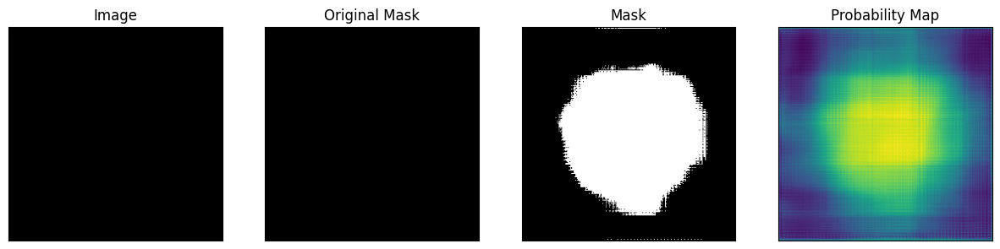

1


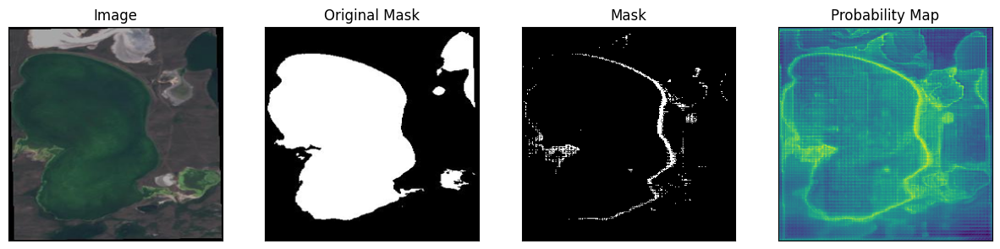

2


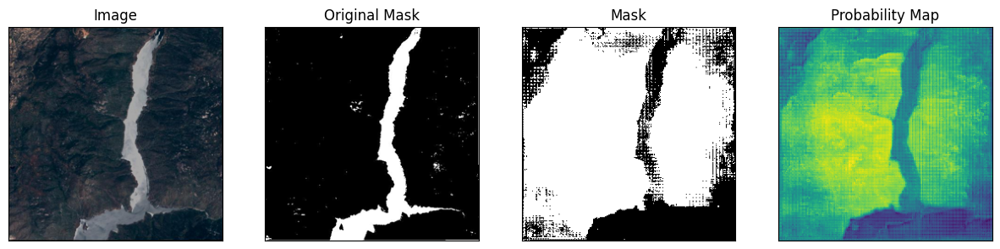

3


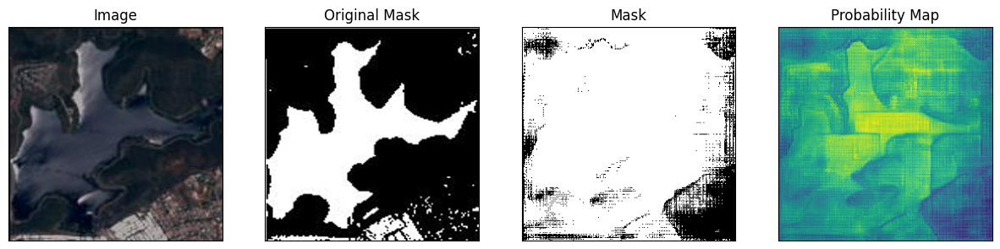

4


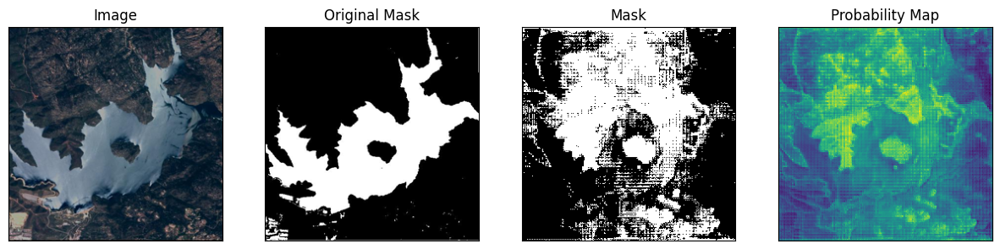

5


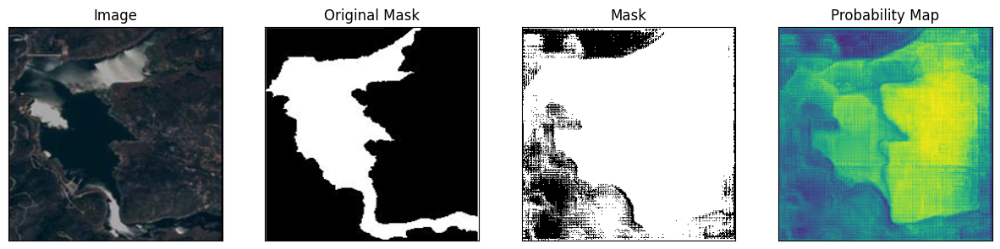

6


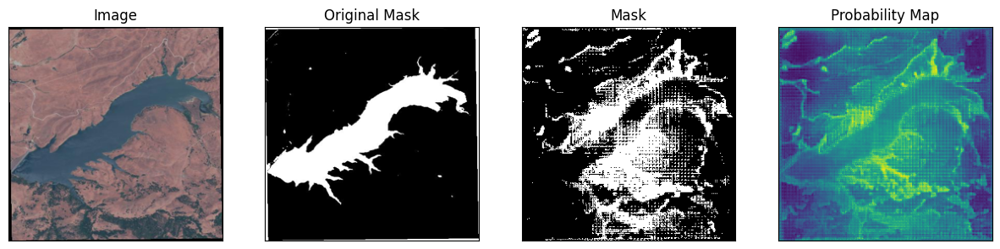

7


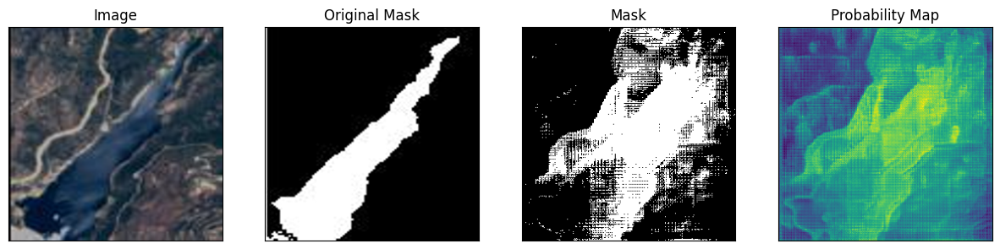

8


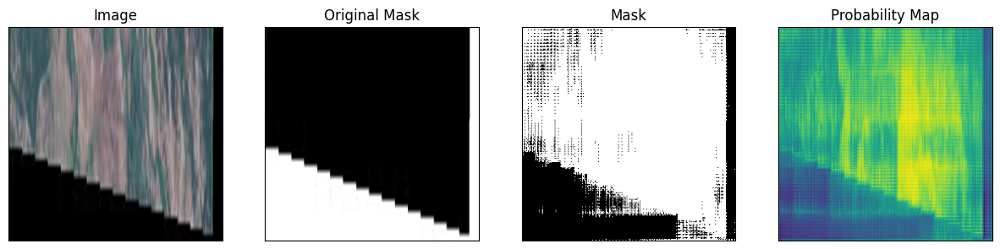

9


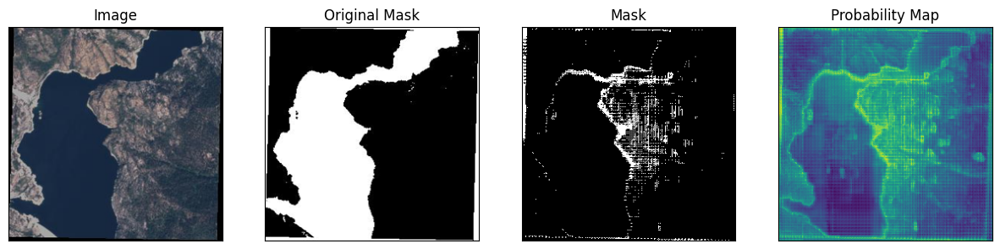

10


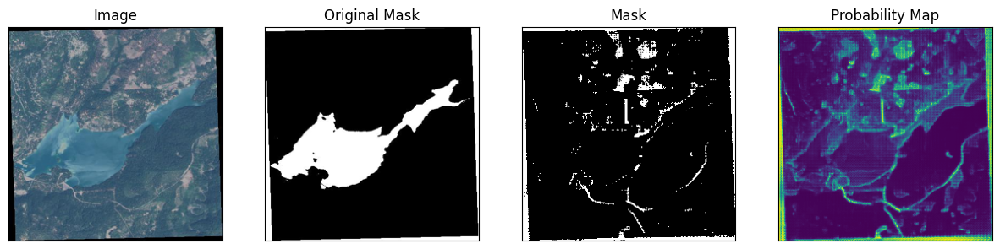

11


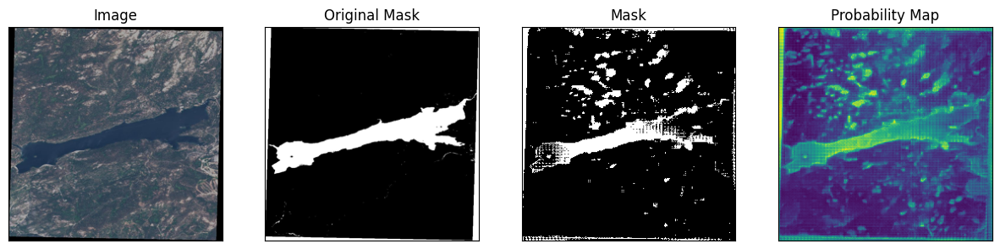

12


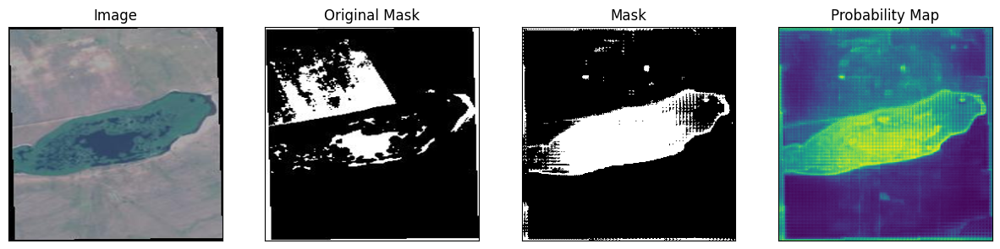

13


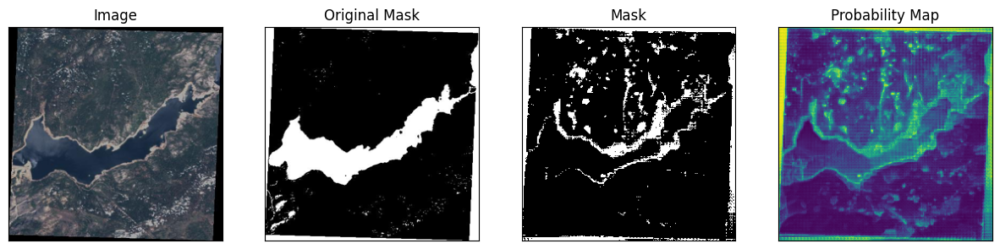

14


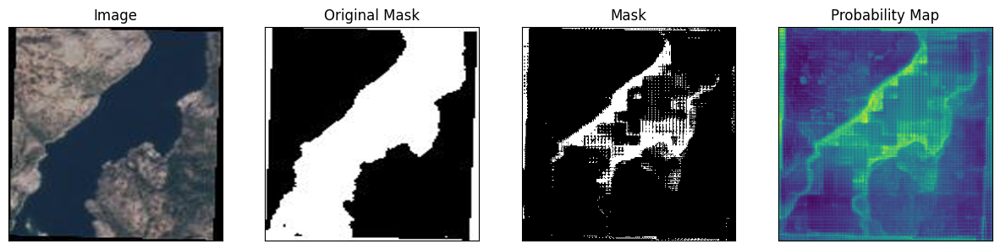

15


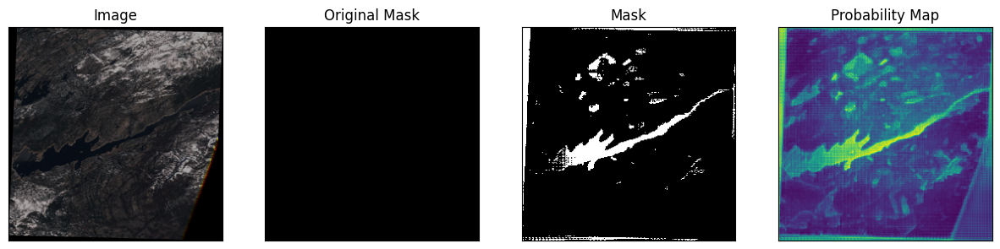

16


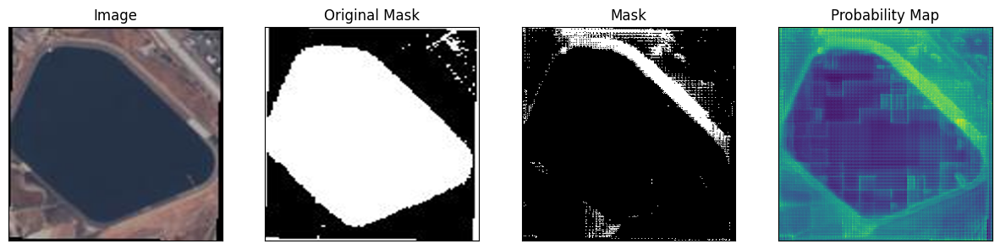

17


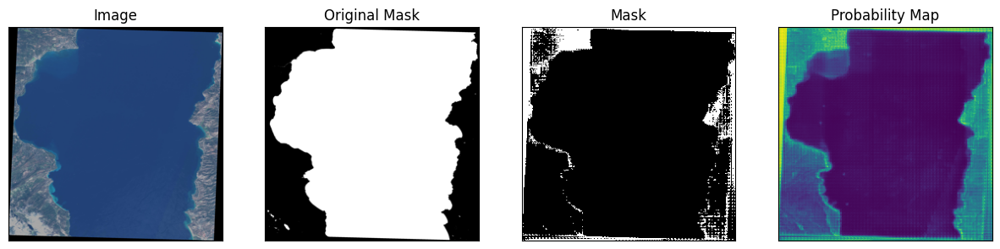

18


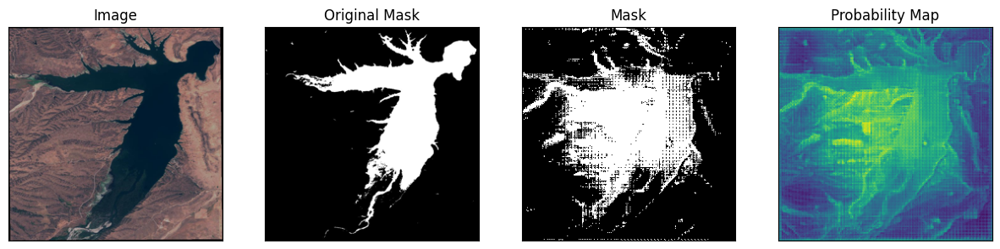

19


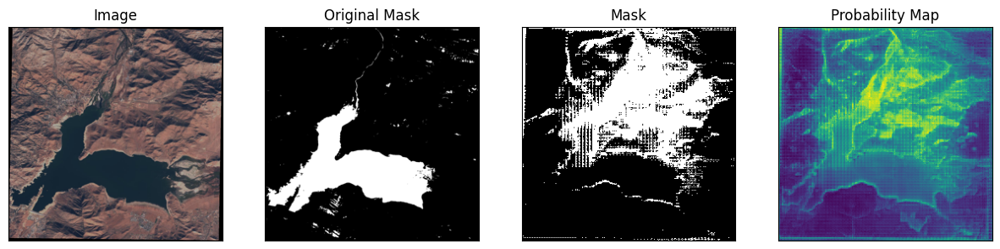

20


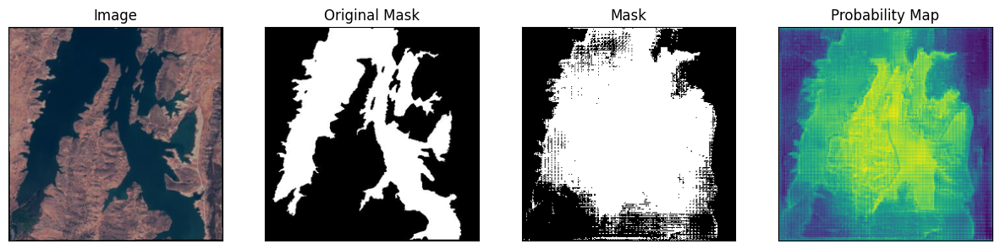

21


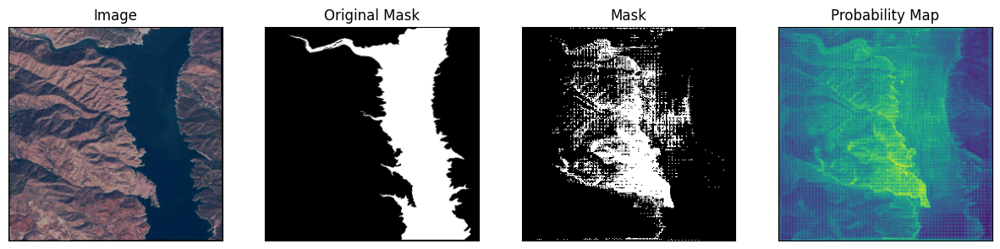

22


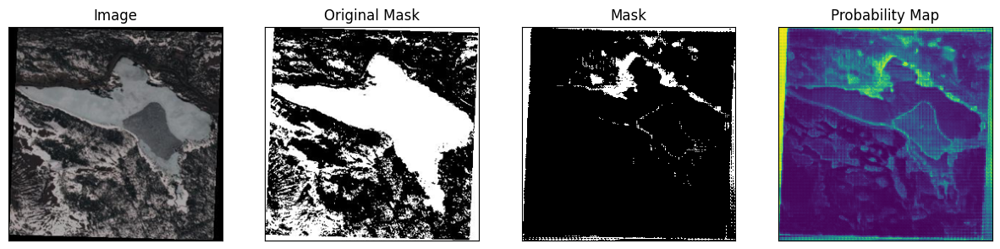

23


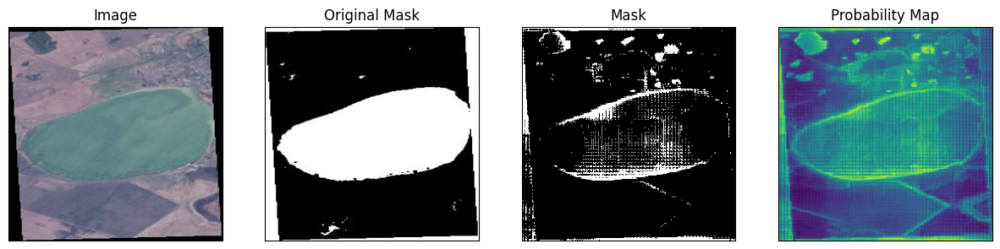

24


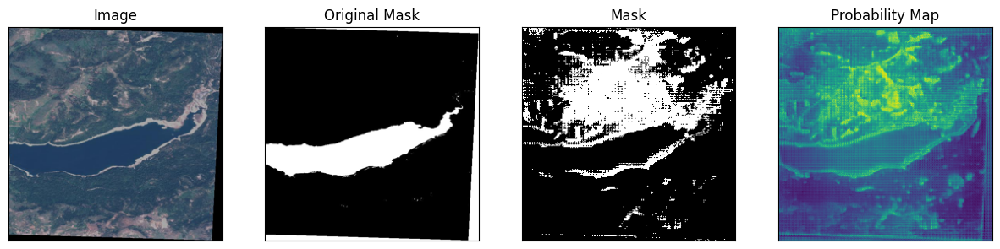

25


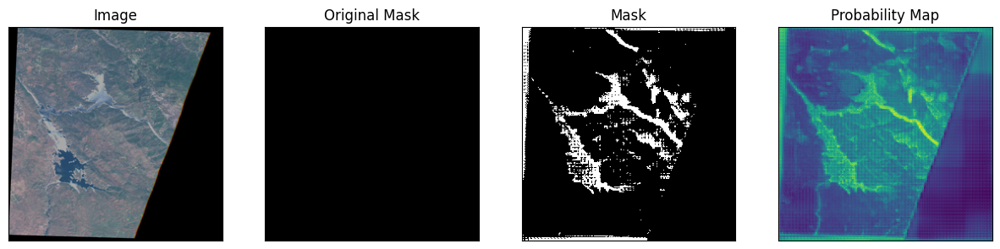

26


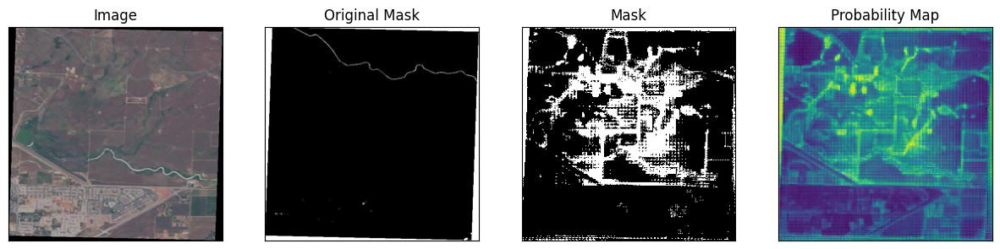

27


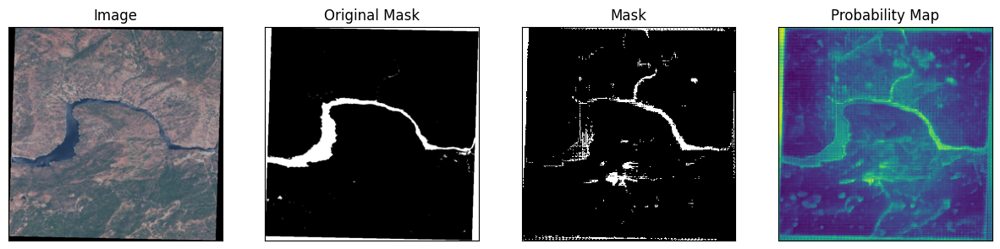

28


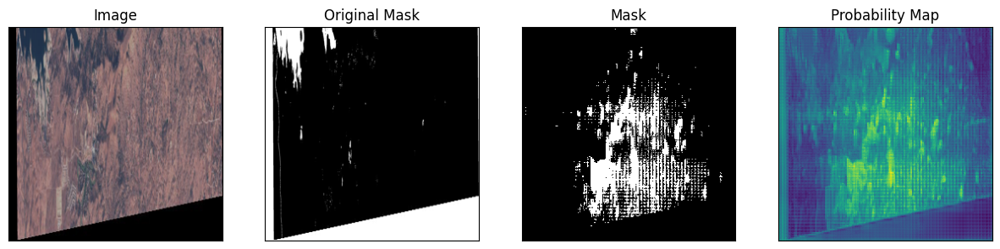

29


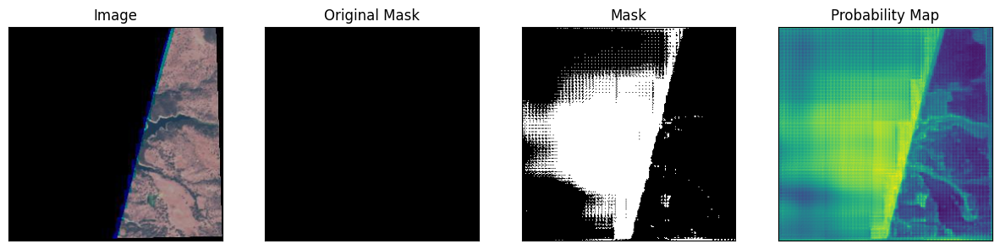

30


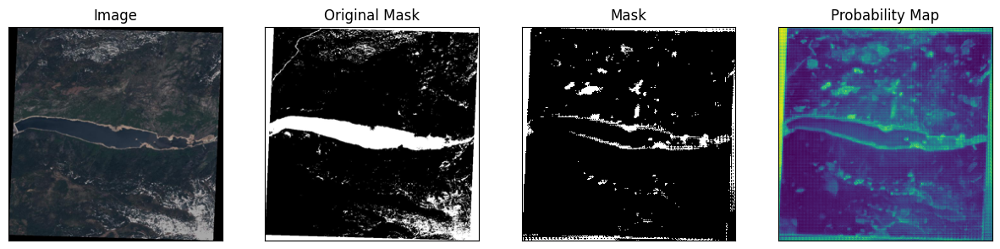

31


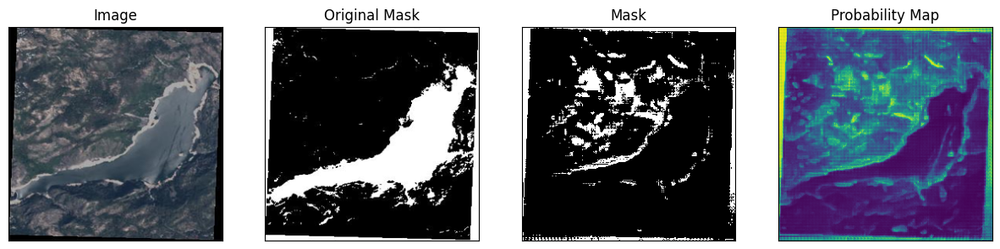

32


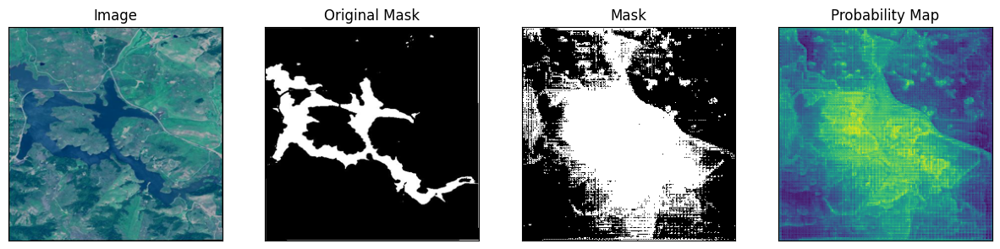

33


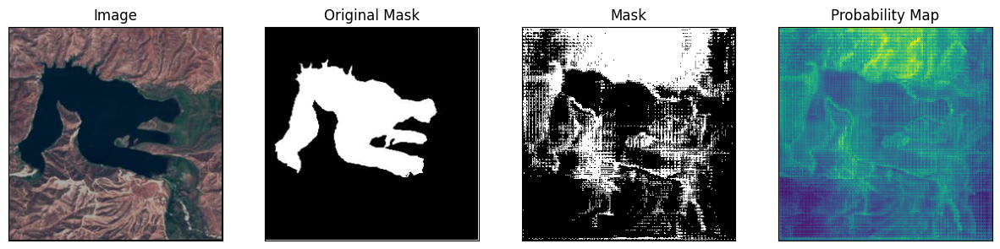

34


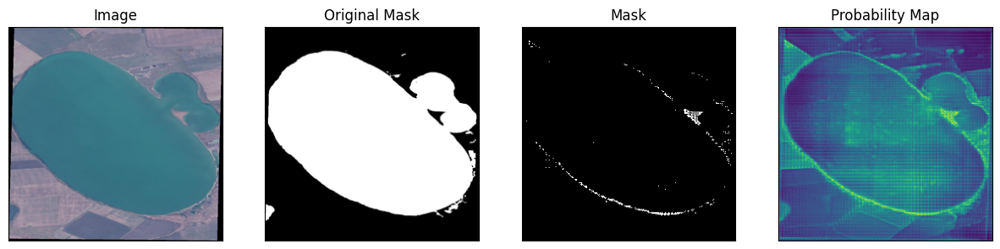

35


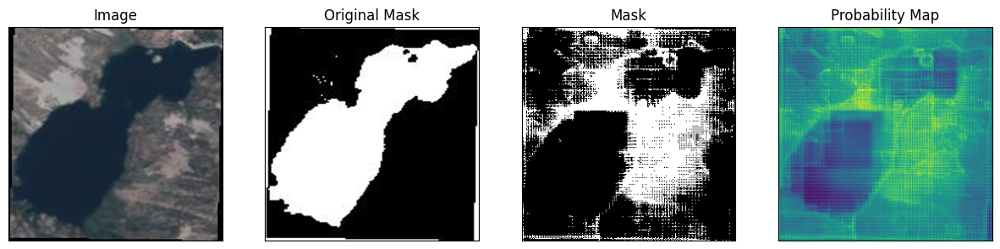

36


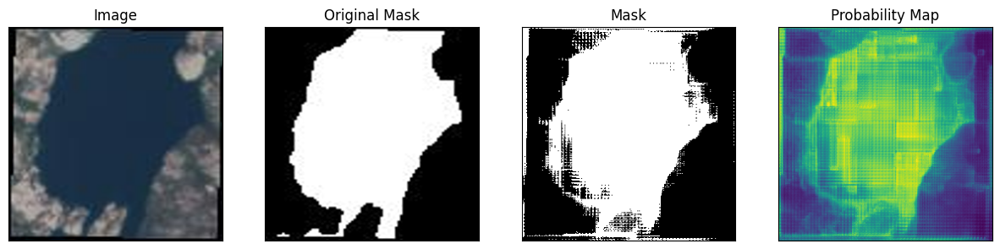

37


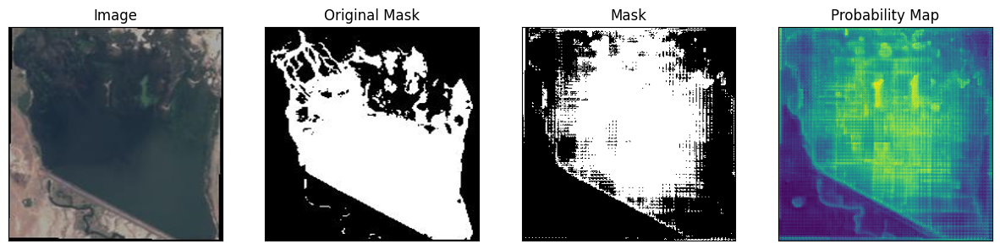

38


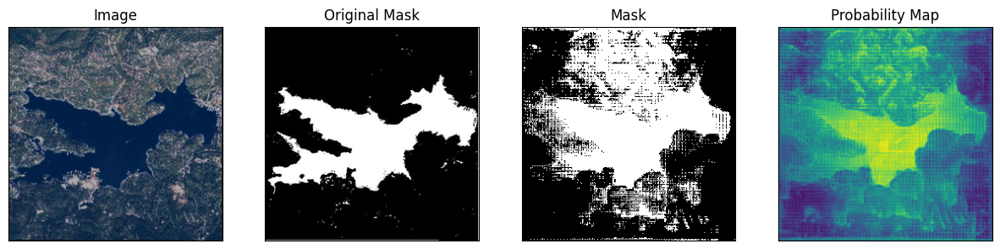

39


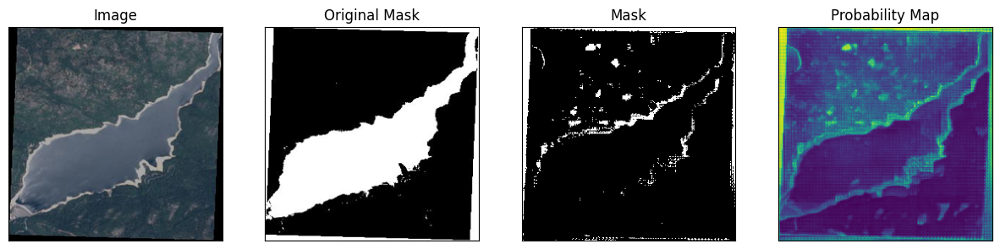

40


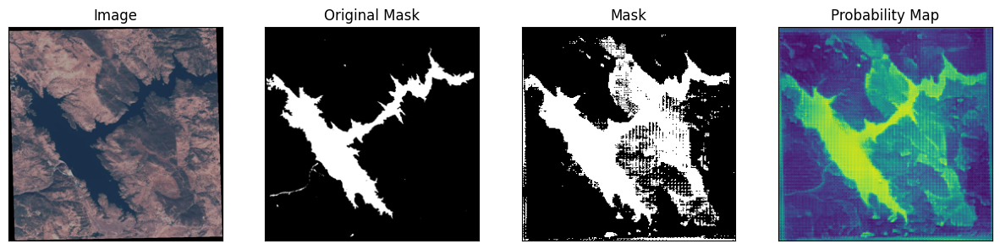

41


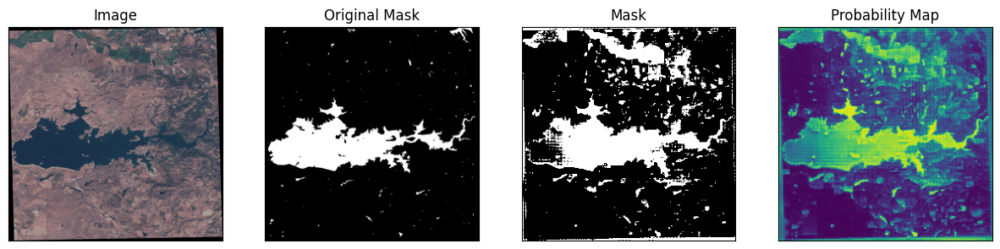

42


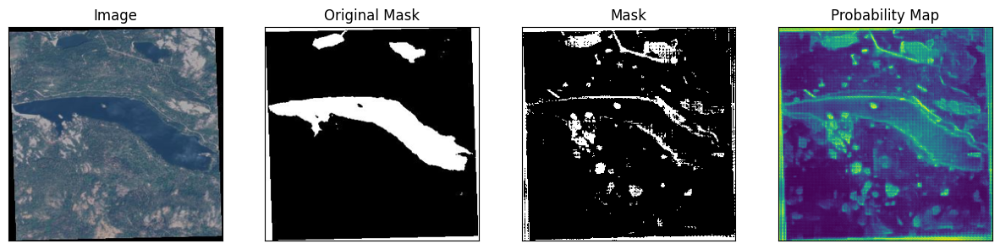

43


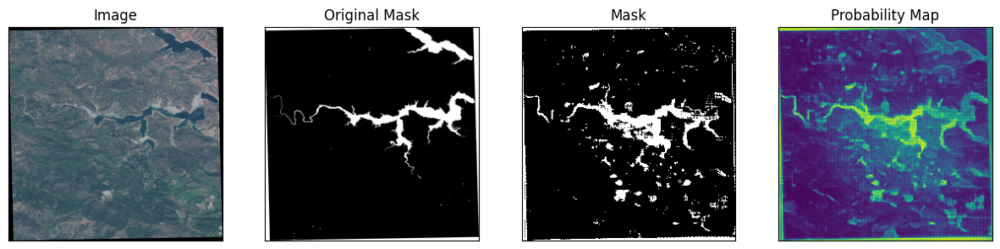

44


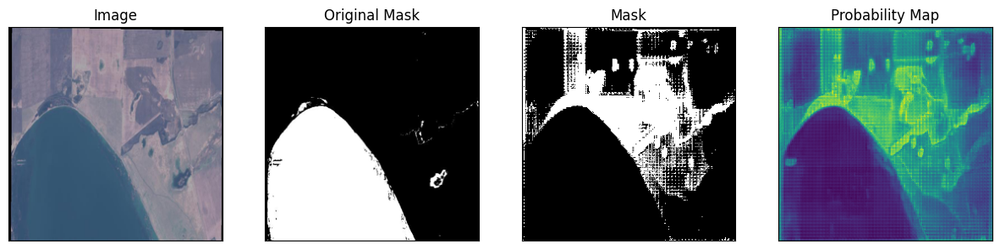

45


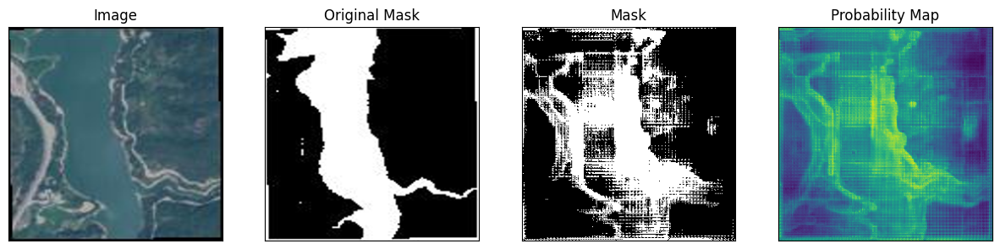

46


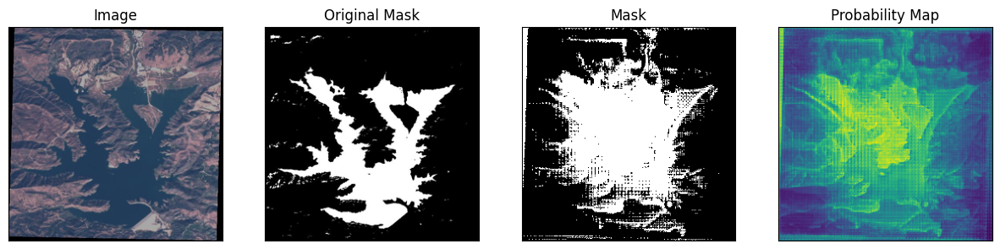

47


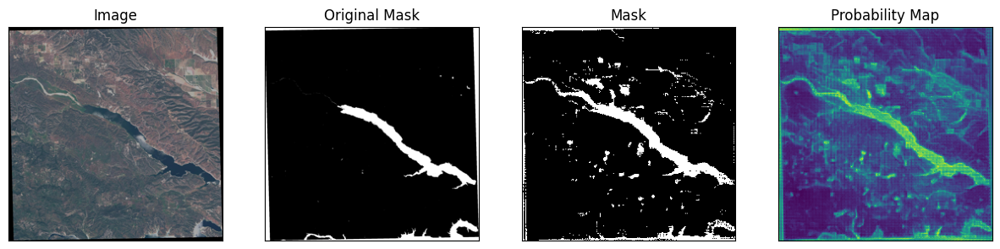

48


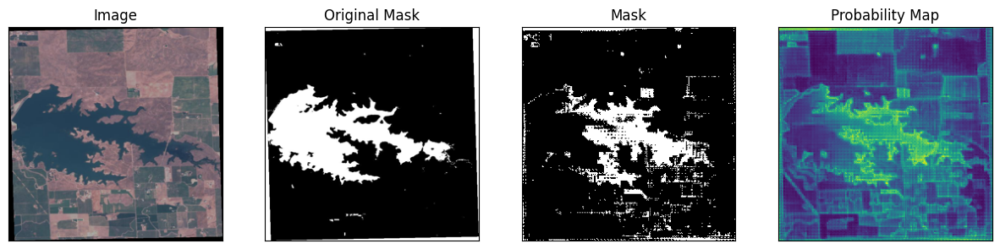

49


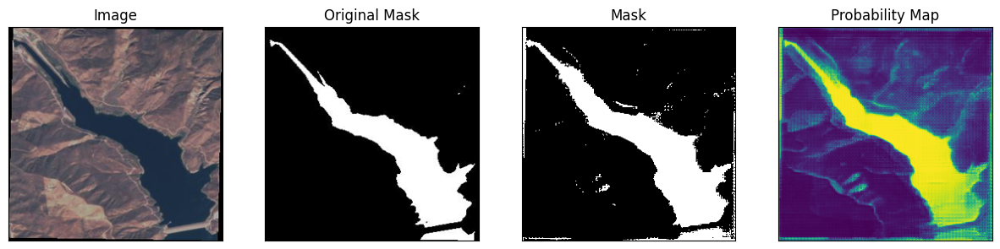

50


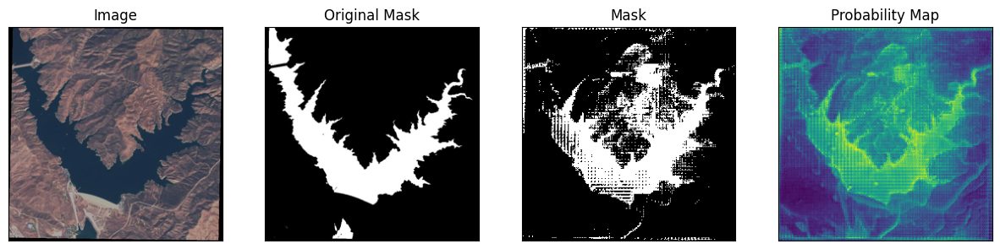

51


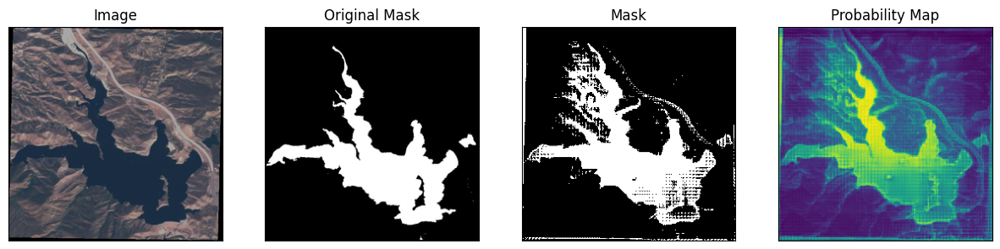

52


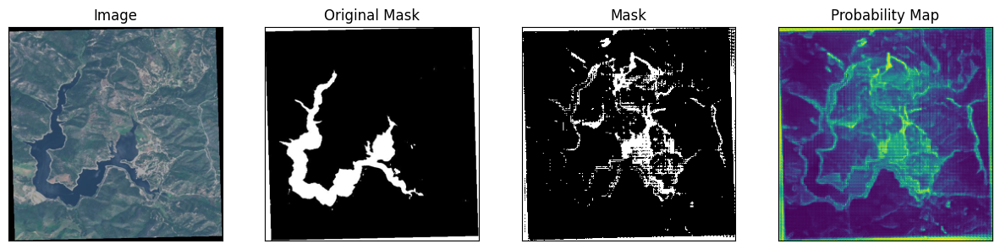

53


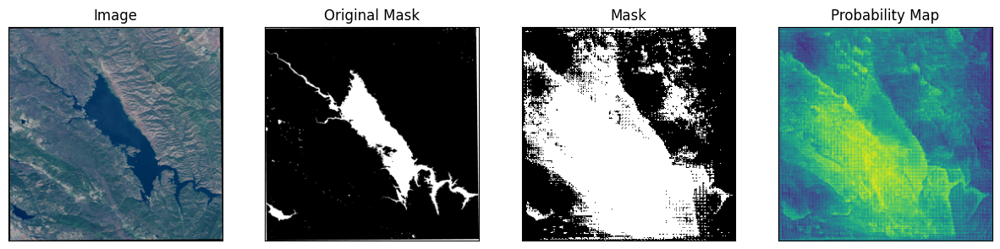

54


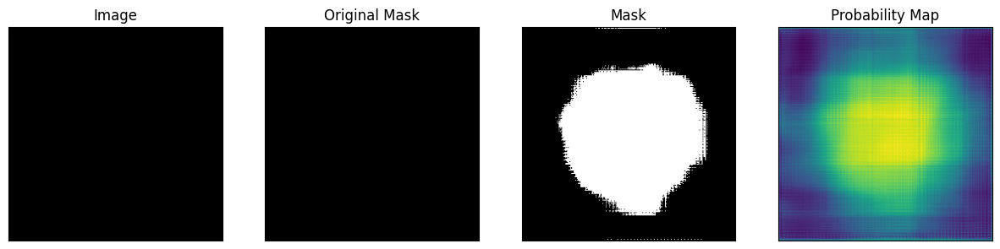

55


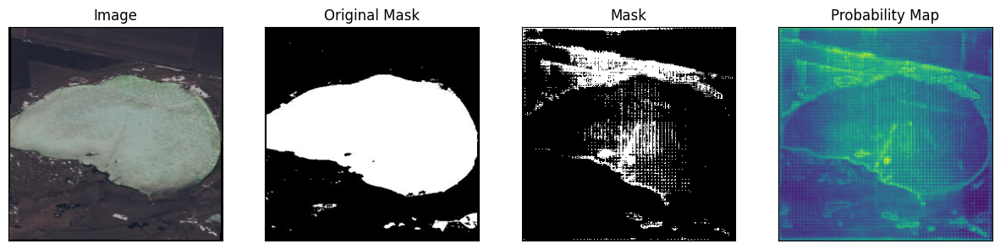

56


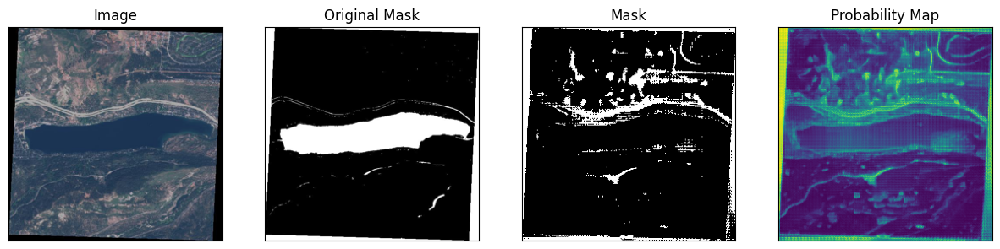

57


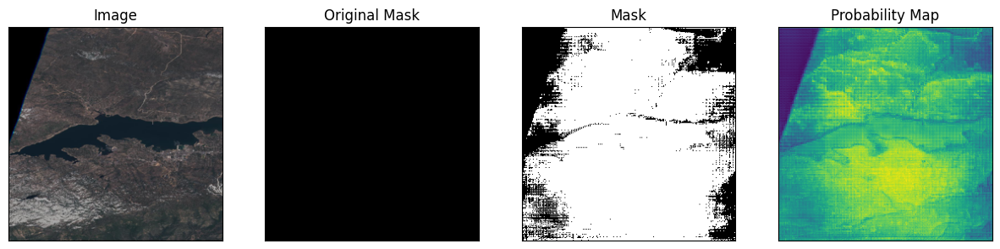

58


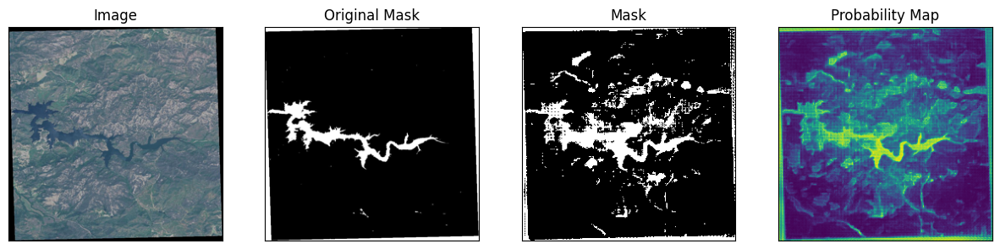

59


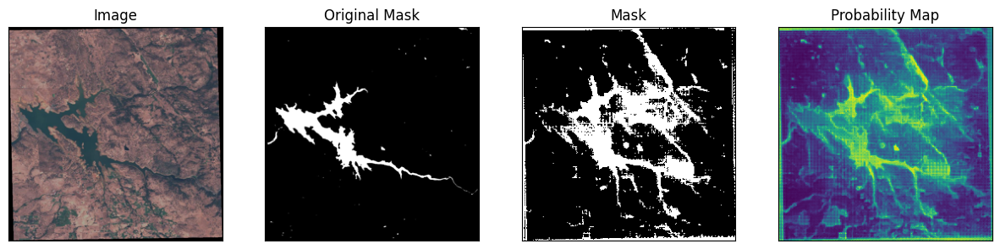

60


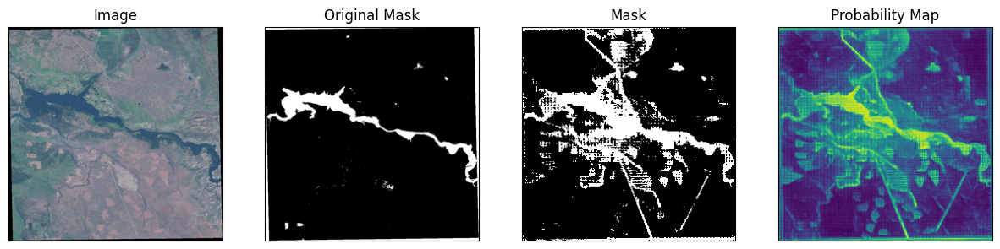

61


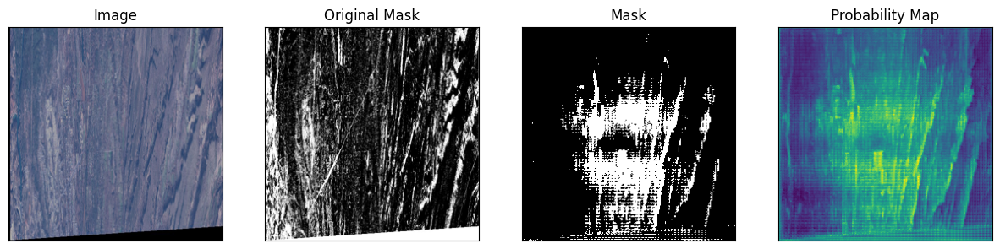

62


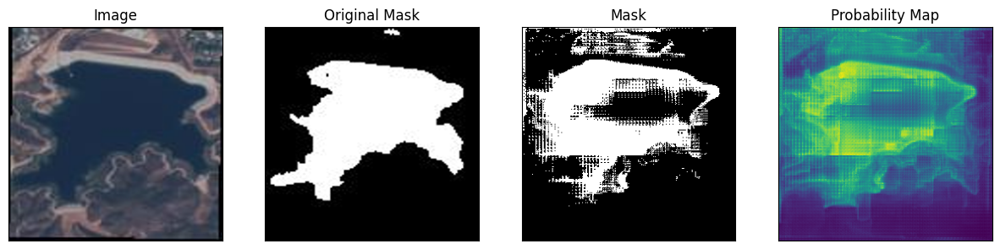

63


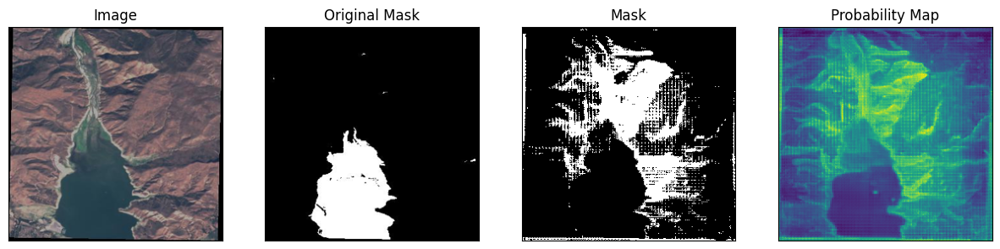

64


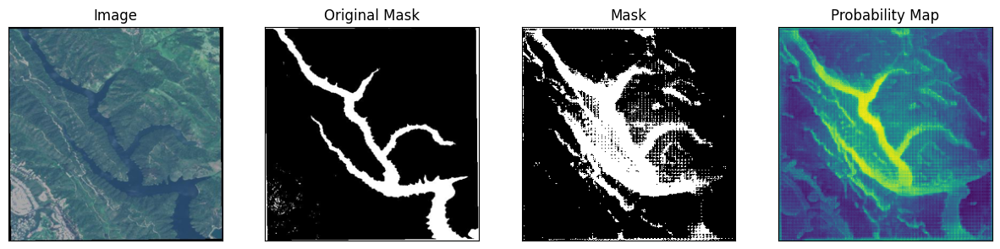

65


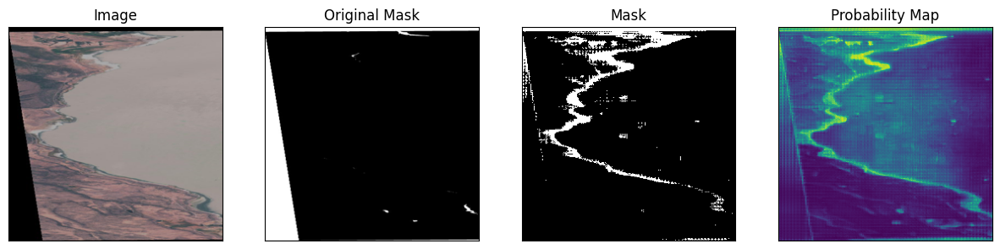

66


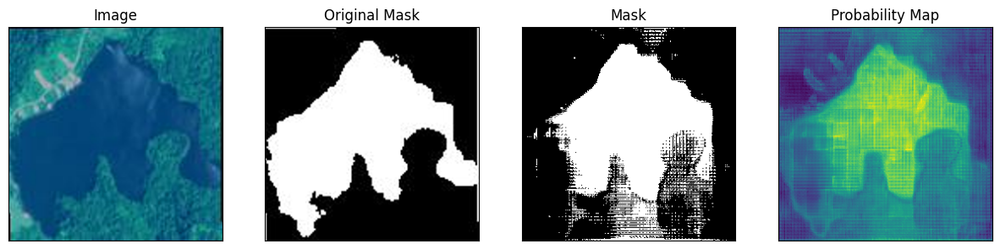

67


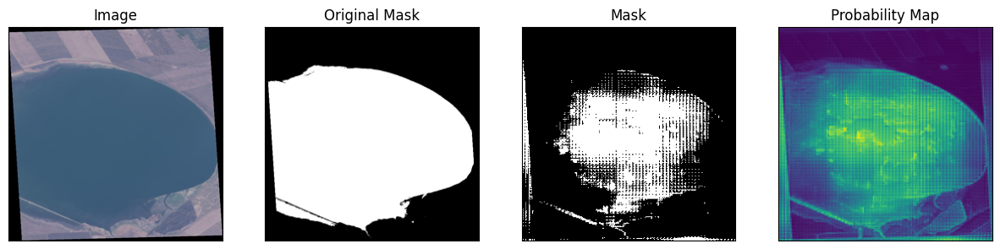

68


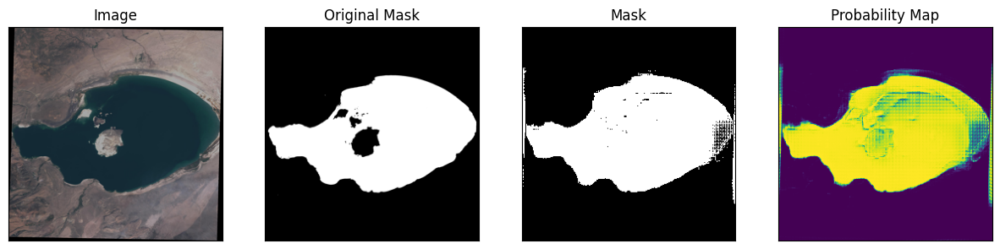

69


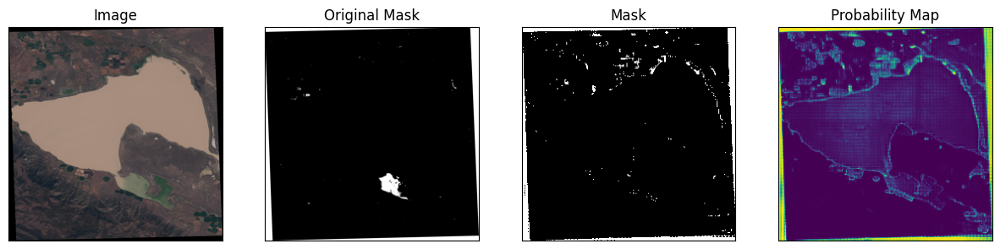

70


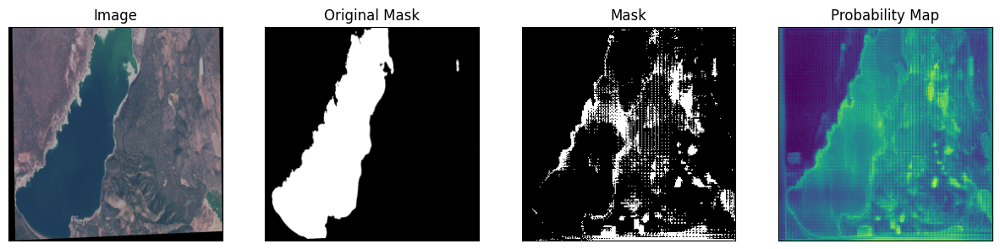

71


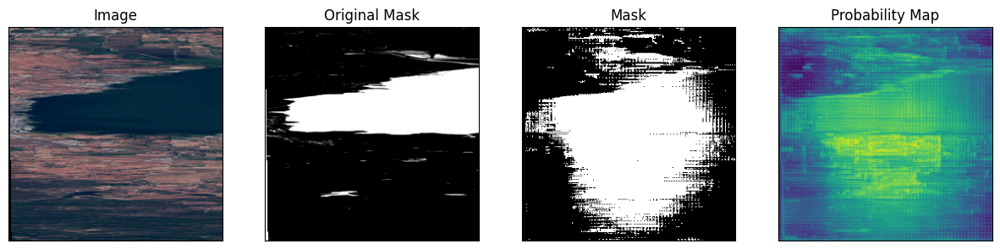

72


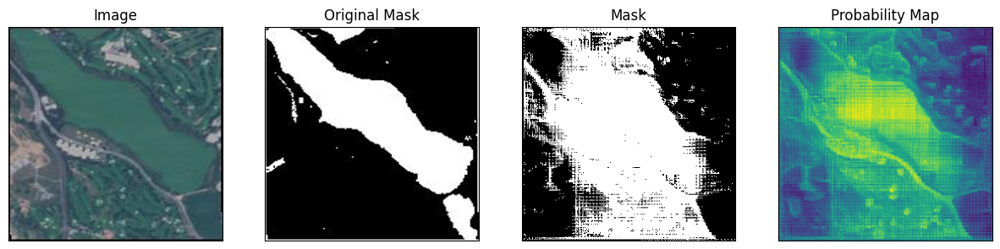

73


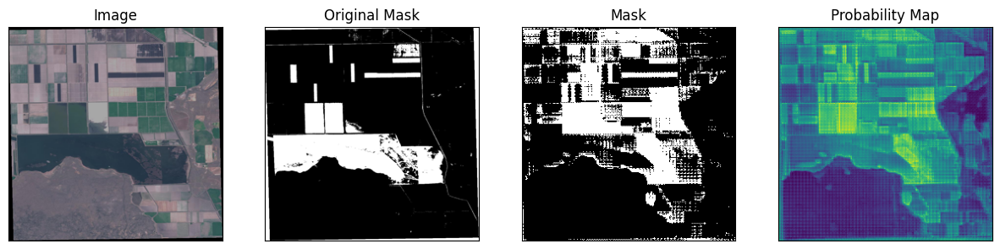

74


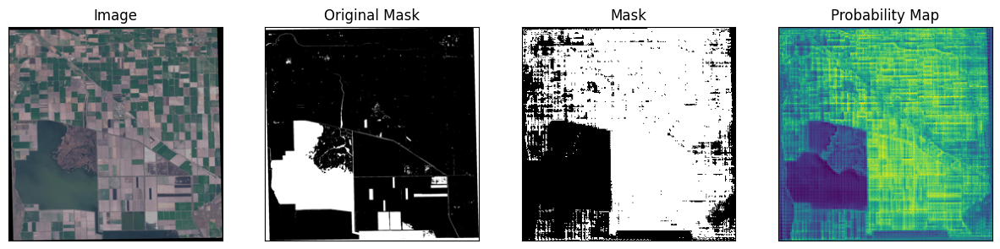

75


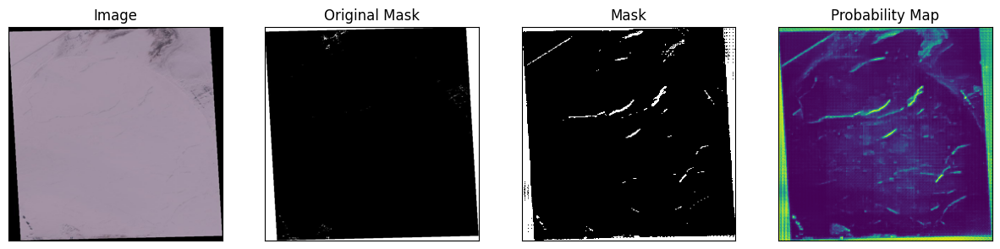

76


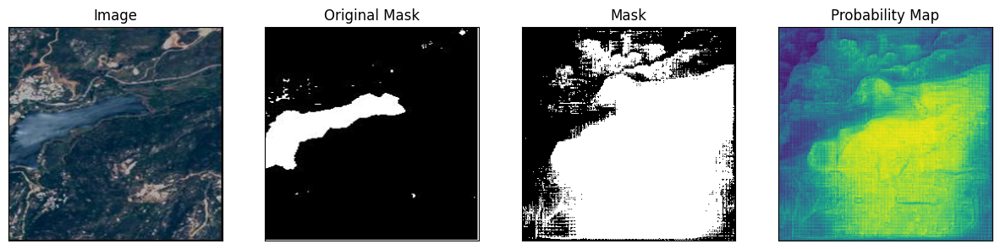

77


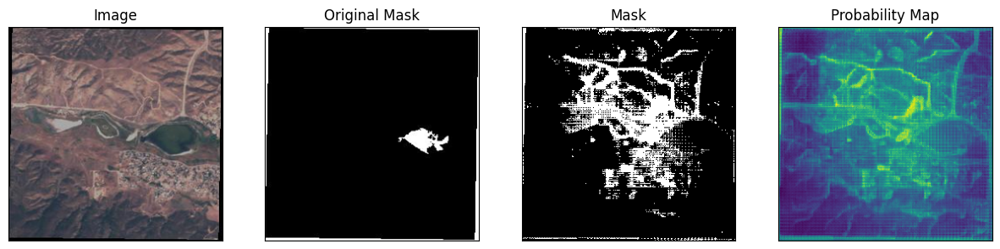

78


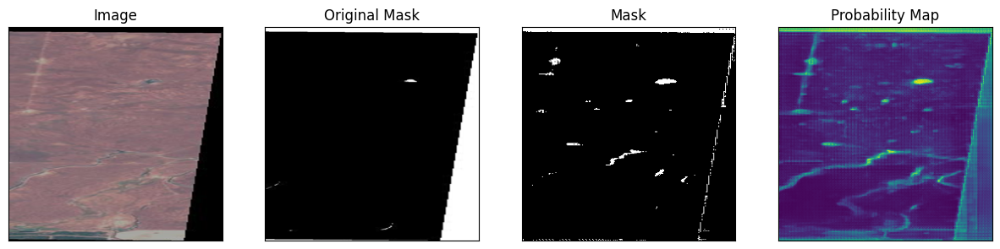

79


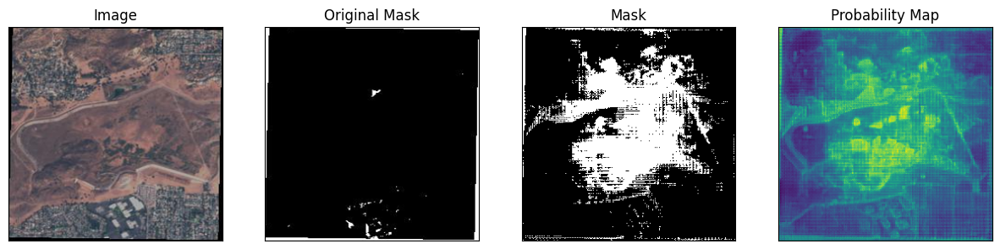

80


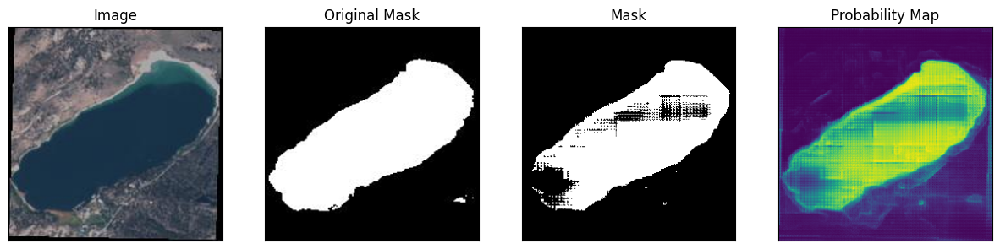

81


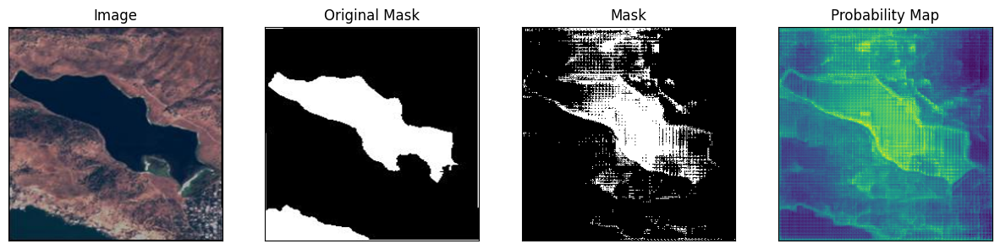

82


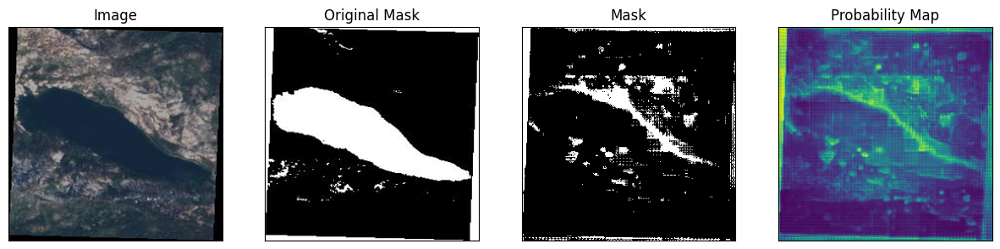

83


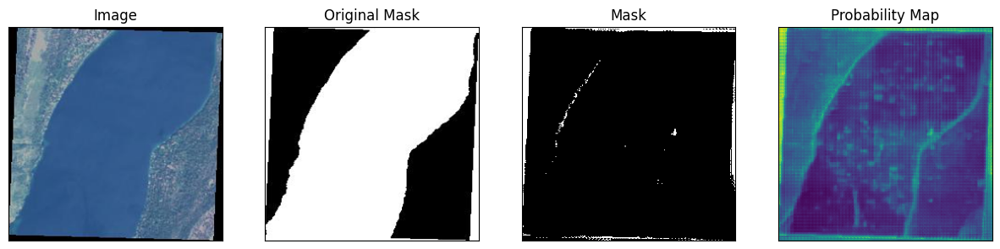

84


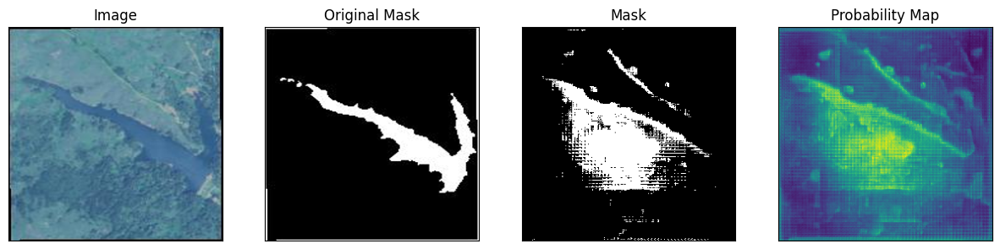

85


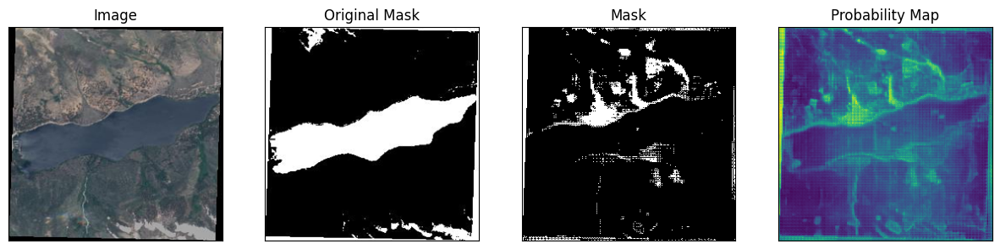

86


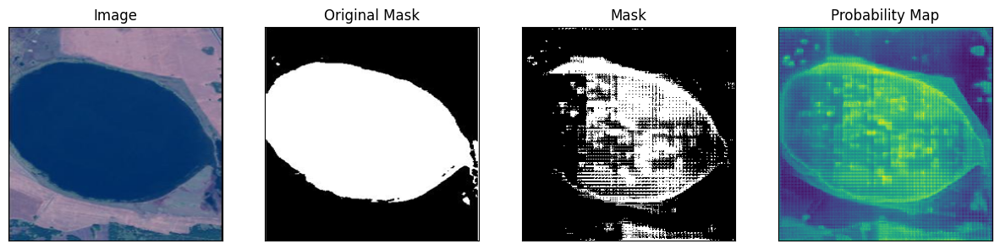

87


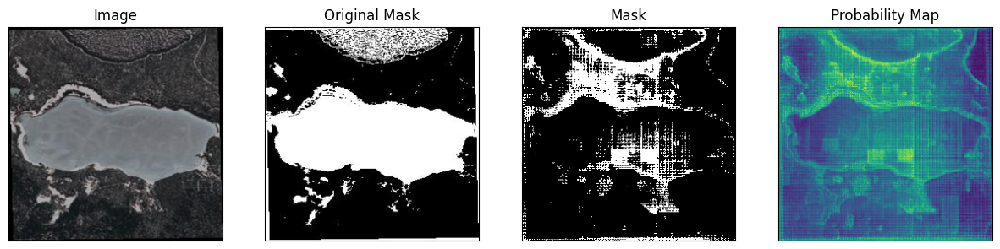

88


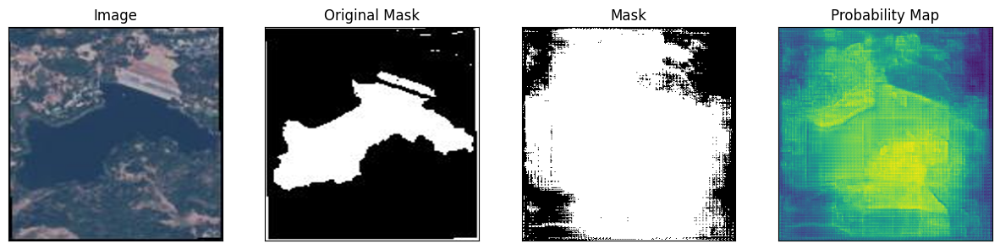

89


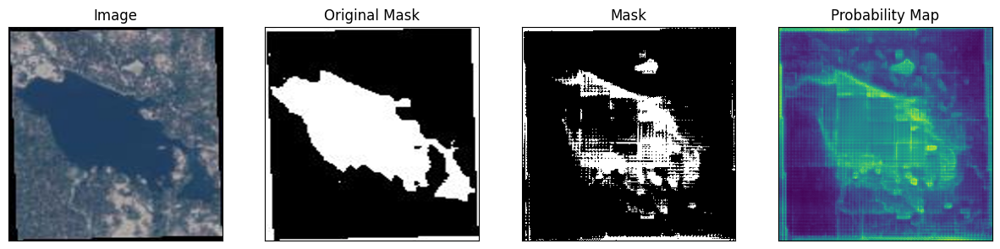

90


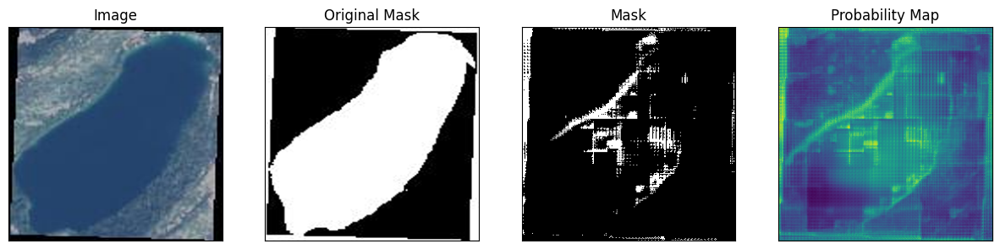

91


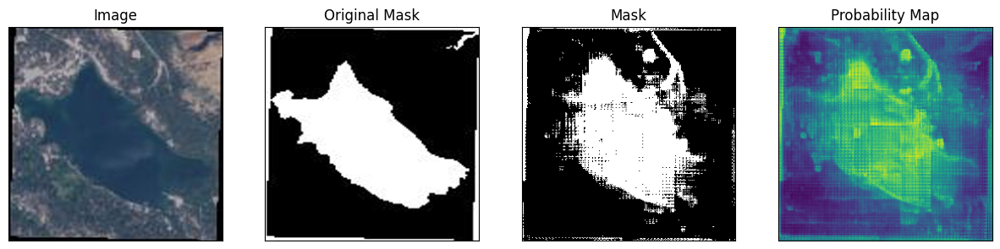

92


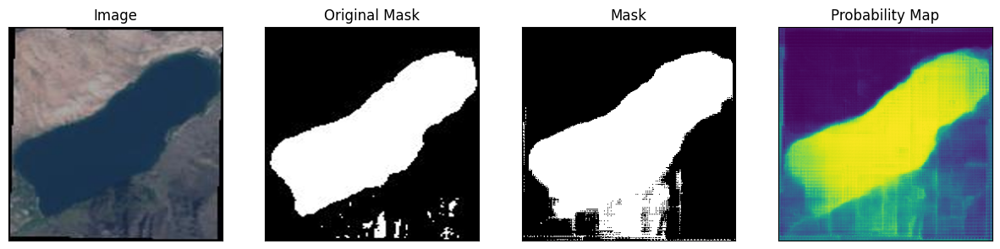

93


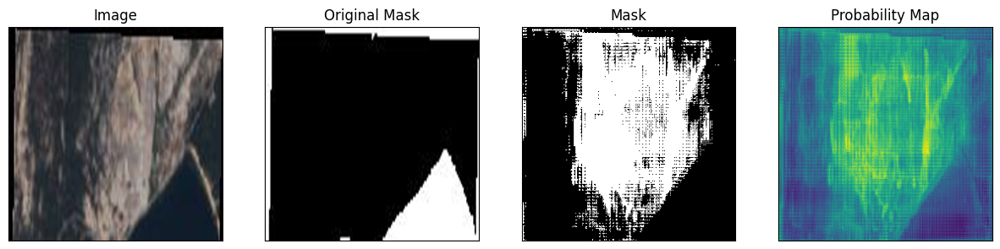

94


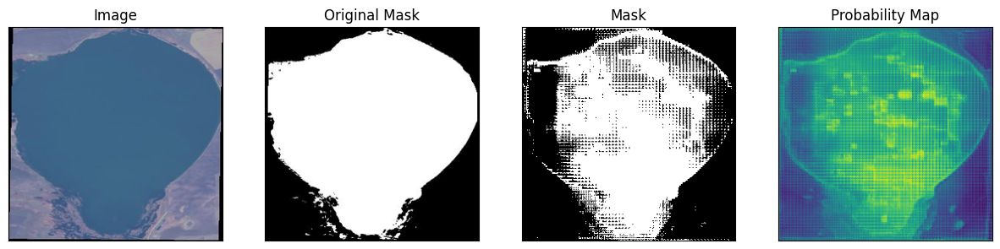

95


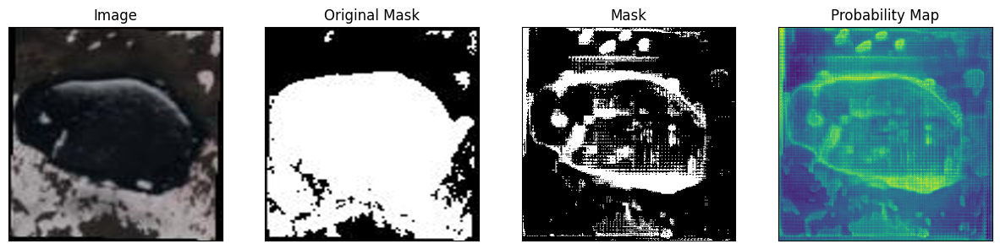

96


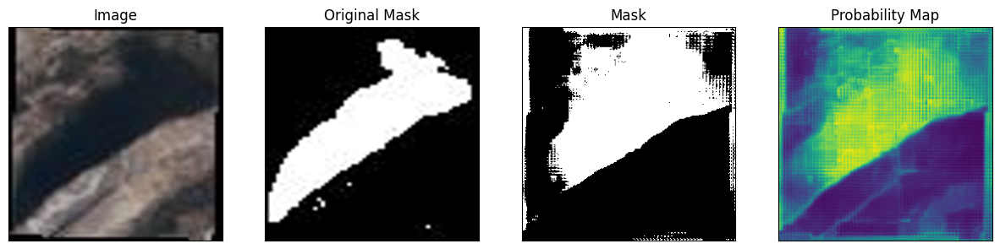

97


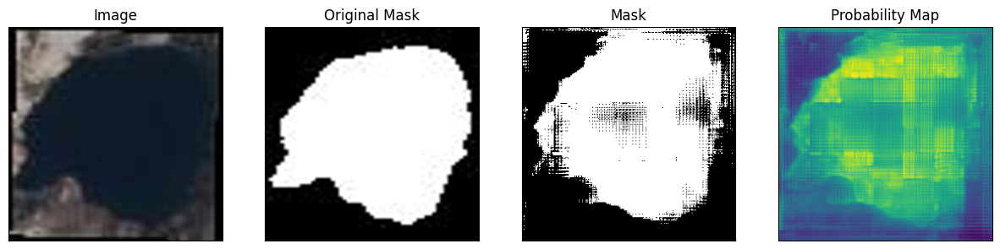

98


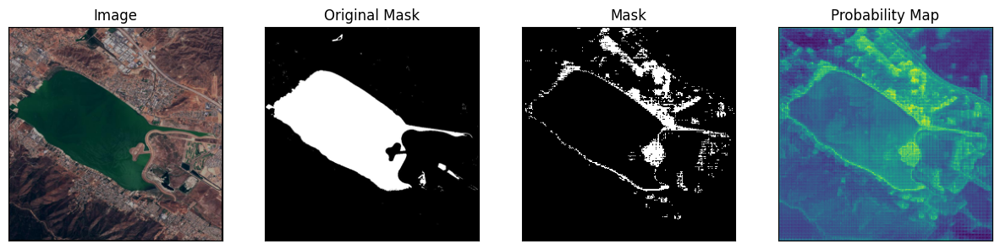

99


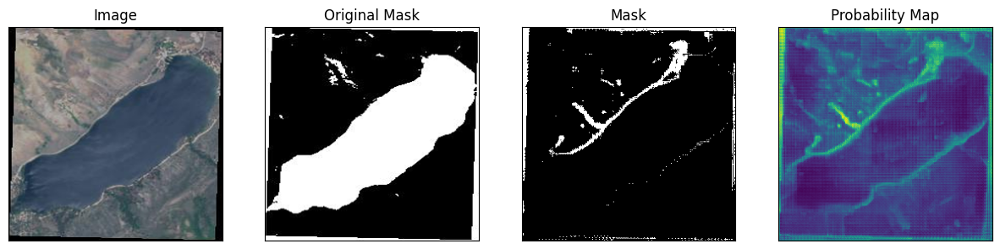

In [ ]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt

for idx in range(0,100):
  print(idx)
  # load image
  test_image = dataset_test[idx]["image"]

  # get box prompt based on ground truth segmentation map
  ground_truth_mask = np.array(dataset_test[idx]["label"])
  prompt = get_bounding_box(ground_truth_mask)

  # prepare image + box prompt for the model
  inputs = processor(test_image, input_boxes=[[prompt]], return_tensors="pt")

  # Move the input tensor to the GPU if it's not already there
  inputs = {k: v.to(device) for k, v in inputs.items()}

  my_mito_model.eval()

  # forward pass
  with torch.no_grad():
      outputs = my_mito_model(**inputs, multimask_output=False)

  # apply sigmoid
  medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
  # convert soft mask to hard mask
  medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
  medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)


  fig, axes = plt.subplots(1, 4, figsize=(15, 5))

  # Plot the first image on the left
  axes[0].imshow(np.array(test_image), cmap='gray')  # Assuming the first image is grayscale
  axes[0].set_title("Image")

  axes[1].imshow(np.array(ground_truth_mask), cmap='gray')  # Assuming the first image is grayscale
  axes[1].set_title("Original Mask")

  # Plot the second image on the right
  axes[2].imshow(medsam_seg,cmap='gray')  # Assuming the second image is grayscale
  axes[2].set_title("Mask")

  # Plot the second image on the right
  axes[3].imshow(medsam_seg_prob)  # Assuming the second image is grayscale
  axes[3].set_title("Probability Map")

  # Hide axis ticks and labels
  for ax in axes:
      ax.set_xticks([])
      ax.set_yticks([])
      ax.set_xticklabels([])
      ax.set_yticklabels([])

  # Display the images side by side
  plt.show()
